In [1]:
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import numpy as np
import seaborn as sns
sns.set_theme()
import warnings
warnings.filterwarnings("ignore")
from sklearn import preprocessing, cluster
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.cluster import AffinityPropagation
import re
import time
import random
import pickle
import locale
from datetime import datetime
import plotly.graph_objects as go

C:\Users\Diego\anaconda3\envs\for_py\lib\site-packages\geopandas\_compat.py:123: UserWarning: The Shapely GEOS version (3.10.3-CAPI-1.16.1) is incompatible with the GEOS version PyGEOS was compiled with (3.10.4-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


In [2]:
%matplotlib widget

# Data Colonias

In [3]:
path_col_data="data/Colonias/mgpc_2019.dbf"
df_col = gpd.read_file(path_col_data)

In [4]:
len(df_col.columns),df_col.columns

(9,
 Index(['ENT', 'CVEDT', 'NOMDT', 'DTTOLOC', 'CVEUT', 'NOMUT', 'POB2010', 'ID',
        'geometry'],
       dtype='object'))

In [5]:
df_col.head(2)

,ENT,CVEDT,NOMDT,DTTOLOC,CVEUT,NOMUT,POB2010,ID,geometry
0,9,2,AZCAPOTZALCO,05,02-001,AGUILERA,2014,1,"POLYGON ((483311.618 2153254.848, 483332.006 2..."
1,9,2,AZCAPOTZALCO,05,02-002,ALDANA,3378,2,"POLYGON ((484406.956 2153012.331, 484401.132 2..."


In [6]:
df_col[df_col["NOMUT"].str.contains("CONDESA")]

,ENT,CVEDT,NOMDT,DTTOLOC,CVEUT,NOMUT,POB2010,ID,geometry
425,9,15,CUAUHTEMOC,12,15-008,CONDESA,8453,426,"POLYGON ((481115.551 2146824.670, 481119.607 2..."
439,9,15,CUAUHTEMOC,12,15-016,HIPODROMO CONDESA,3204,440,"POLYGON ((480855.403 2146357.767, 480879.017 2..."


In [7]:
df_col[df_col["NOMUT"]=="CONDESA"]

,ENT,CVEDT,NOMDT,DTTOLOC,CVEUT,NOMUT,POB2010,ID,geometry
425,9,15,CUAUHTEMOC,12,15-008,CONDESA,8453,426,"POLYGON ((481115.551 2146824.670, 481119.607 2..."


In [8]:
# Add notations of colonias in map
# axis = df_col.plot(color="lightblue",edgecolor = "black",figsize = (12,12))
# for i,k,l in zip(df_col["NOMUT"],df_col.centroid.x,df_col.centroid.y):
#     axis.annotate(i, (k, l), fontsize=4)

In [9]:
col_var_sele=["NOMUT","ID","geometry"]
df_col_selec=df_col[col_var_sele]

In [10]:
# Cambiamos el formato 
df_col_43=df_col_selec.to_crs(epsg=4326)

In [11]:
df_col_43

,NOMUT,ID,geometry
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473..."
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471..."
2,ANGEL ZIMBRON,3,"POLYGON ((-99.19044 19.47144, -99.19031 19.471..."
3,ARENAL,4,"POLYGON ((-99.15187 19.46803, -99.15186 19.468..."
4,CENTRO DE AZCAPOTZALCO,5,"POLYGON ((-99.18959 19.48519, -99.18946 19.485..."
...,...,...,...
1810,VILLA PROGRESISTA,1811,"POLYGON ((-99.24369 19.35705, -99.24358 19.357..."
1811,VILLA SOLIDARIDAD,1812,"POLYGON ((-99.21851 19.38293, -99.21861 19.382..."
1812,VILLA VERDUN,1813,"POLYGON ((-99.25629 19.34239, -99.25639 19.342..."
1813,ZENON DELGADO,1814,"POLYGON ((-99.21591 19.39240, -99.21585 19.392..."


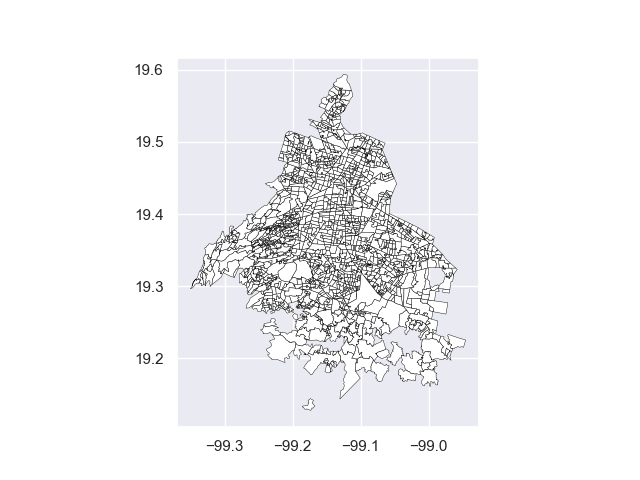

In [12]:
# Setup figure and axis
f, ax = plt.subplots(1)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=0.3, color='white', edgecolor='black')
plt.show()

# Data Mercados

In [13]:
path_merca="data/Mercados/MERCADOS_ADIP.shp"
df_merc = gpd.read_file(path_merca)

In [14]:
df_merc.head(2)

,N°,DELEGACION,MERCADO,NUM_OFIC,NUM_LOCALE,Coord_Y,Coord_X,DIRECCION,COLONIA,TIPO,...,ANTIGÜEDA,VOCACIÓN,DETALLE,FORMA,NIVELES,TAMAÑO1,PROTEGIDO,COORGEOG_X,COORGEOG_Y,geometry
0,18.0,AZCAPOTZALCO,AZCAPOTZALCO,35.0,546.0,2.154268e+06,480539.52674,AV. AZCAPOTZALCO ENTRE ESPERANZA Y RAYON,AZCAPOTZALCO,TRADICIONAL,...,63.0,N/D,N/D,CUADRO,1,MEDIANO,SI,-99.185439,19.482872,POINT Z (-99.18544 19.48287 0.00000)
1,20.0,AZCAPOTZALCO,CLAVERIA,46.0,98.0,2.152290e+06,480987.33324,IRAPUATO Y CLAVERIA S/N,CLAVERIA,TRADICIONAL,...,73.0,N/D,N/D,CUADRO,1,CHICO,NO,-99.181152,19.465003,POINT Z (-99.18115 19.46500 0.00000)


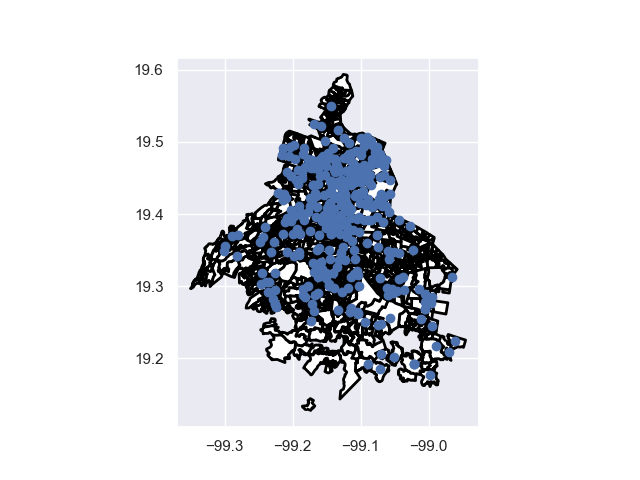

In [15]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
df_merc.plot(ax=ax)
# Display
plt.show()

In [16]:
df_merc["COLONIA"].value_counts()

CENTRO                      13
MERCED CENTRO                9
MORELOS                      6
PEDREGAL SANTO DOMINGO       4
JAMAICA                      3
                            ..
AMP. AGRICOLA ORIENTAL       1
EL RODEO                     1
EJIDO MAGDALENA MIXIHUCA     1
BARRIO SAN MIGUEL            1
LOMAS DE PADIERNA SUR        1
Name: COLONIA, Length: 263, dtype: int64

## 1) Join : Ubicación de los mercados en las Colonias 

In [17]:
joined_df = gpd.sjoin(
    df_merc,
    df_col_43,
    how='inner',
    op='intersects',
)

In [18]:
joined_df.head(2)

,N°,DELEGACION,MERCADO,NUM_OFIC,NUM_LOCALE,Coord_Y,Coord_X,DIRECCION,COLONIA,TIPO,...,FORMA,NIVELES,TAMAÑO1,PROTEGIDO,COORGEOG_X,COORGEOG_Y,geometry,index_right,NOMUT,ID
0,18.0,AZCAPOTZALCO,AZCAPOTZALCO,35.0,546.0,2.154268e+06,480539.52674,AV. AZCAPOTZALCO ENTRE ESPERANZA Y RAYON,AZCAPOTZALCO,TRADICIONAL,...,CUADRO,1,MEDIANO,SI,-99.185439,19.482872,POINT Z (-99.18544 19.48287 0.00000),4,CENTRO DE AZCAPOTZALCO,5
1,20.0,AZCAPOTZALCO,CLAVERIA,46.0,98.0,2.152290e+06,480987.33324,IRAPUATO Y CLAVERIA S/N,CLAVERIA,TRADICIONAL,...,CUADRO,1,CHICO,NO,-99.181152,19.465003,POINT Z (-99.18115 19.46500 0.00000),5,CLAVERIA,6


In [19]:
count_merc=joined_df["ID"].value_counts().reset_index().rename(columns = {'index':'ID', 'ID':'N_Mercados'})

In [20]:
count_merc.head(2)

,ID,N_Mercados
0,1428,9
1,425,4


In [21]:
df_col_merc = pd.merge(df_col_43, count_merc, how="left", on="ID")

In [22]:
def conver_nan(x):
    try:
        return int(x)
    except:
        return 0
df_col_merc["N_Mercados"]=df_col_merc["N_Mercados"].apply(conver_nan)

In [23]:
df_col_merc.head(4)

,NOMUT,ID,geometry,N_Mercados
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0
2,ANGEL ZIMBRON,3,"POLYGON ((-99.19044 19.47144, -99.19031 19.471...",0
3,ARENAL,4,"POLYGON ((-99.15187 19.46803, -99.15186 19.468...",1


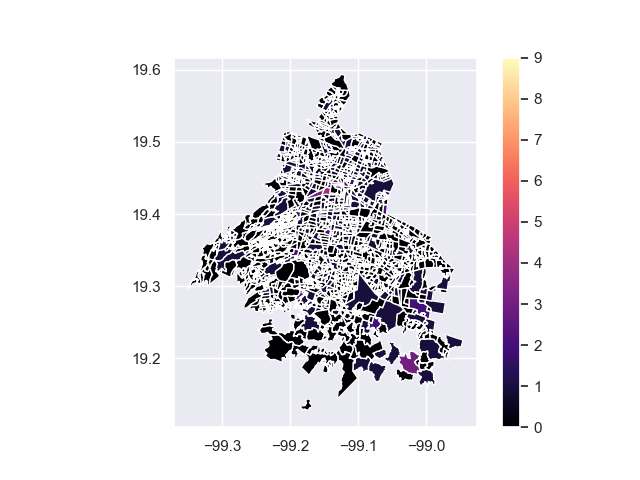

In [24]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=0.3, color='white', edgecolor='black')
# Add a layer with lines on top in axis `ax`
# boscut_snap.head(600).plot(ax=ax, column = 'NOMUT', cmap = 'gist_rainbow')
df_col_merc.plot(ax=ax, column = 'N_Mercados',cmap='magma',legend=True, )
# df_merc.plot(ax=ax, alpha=0.3)
# Display
plt.show()

#  Data Manzanas

In [25]:
path_mza="data/09_Manzanas_INV2020_shp/INV2020_IND_PVEU_MZA_09.shp"
df_mza = gpd.read_file(path_mza)

In [26]:
"Cantidad de Variables: " + str(len(df_mza.columns)),df_mza.columns

('Cantidad de Variables: 94',
 Index(['CVEGEO', 'CVE_ENT', 'NOM_ENT', 'CVE_MUN', 'NOM_MUN', 'CVE_LOC',
        'NOM_LOC', 'CVE_AGEB', 'CVE_MZA', 'AMBITO', 'TIPOMZA', 'POBTOT',
        'POBFEM', 'PPOBFEM', 'POBMAS', 'PPOMAS', 'POB0_14', 'POB0_14_P',
        'P15A29A', 'P15A29A_P', 'P30A59A', 'P30A59A_P', 'P_60YMAS',
        'P_60YMAS_P', 'P_CD_T', 'P_CD_P', 'GRAPROES', 'GRAPROES_F',
        'GRAPROES_M', 'VIVTOT', 'VIVPAR', 'VIVPAR_P', 'TVIPAHAB', 'TVIPAHAB_P',
        'VIVNOHAB', 'VIVNOHAB_P', 'PROM_OCUP', 'PRO_OCUP_C', 'V3MASOCU',
        'V3MASOCU_P', 'VPH_PIDT', 'VPH_PIDT_P', 'VPH_C_EL', 'VPH_C_EL_P',
        'VPH_EXSA', 'VPH_EXSA_P', 'VPH_DREN', 'VPH_DREN_P', 'RECUCALL_C',
        'RAMPAS_C', 'PASOPEAT_C', 'BANQUETA_C', 'GUARNICI_C', 'CICLOVIA_C',
        'CICLOCAR_C', 'ALUMPUB_C', 'LETRERO_C', 'TELPUB_C', 'ARBOLES_C',
        'SEMAPEAT_C', 'SEMAAUDI_C', 'PARATRAN_C', 'ESTABICI_C', 'DRENAJEP_C',
        'TRANSCOL_C', 'ACESOPER_C', 'ACESOAUT_C', 'PUESSEMI_C', 'PUESAMBU_C',
        '

In [27]:
# sele_var=["P30A59A","GRAPROES","TVIPAHAB","CICLOVIA_C","ESTABICI_C","TRANSCOL_C","PUESAMBU_C"]

sele_var=["P30A59A","GRAPROES","TVIPAHAB","geometry"]
df_maza_sv=df_mza[sele_var]

In [28]:
df_maza_sv.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 66386 entries, 0 to 66385
Data columns (total 4 columns):
 #   Column    Non-Null Count  Dtype   
---  ------    --------------  -----   
 0   P30A59A   66386 non-null  object  
 1   GRAPROES  66386 non-null  object  
 2   TVIPAHAB  66386 non-null  object  
 3   geometry  66386 non-null  geometry
dtypes: geometry(1), object(3)
memory usage: 2.0+ MB


In [29]:
df_maza_sv.isna().sum()

P30A59A     0
GRAPROES    0
TVIPAHAB    0
geometry    0
dtype: int64

In [30]:
df_mza_43=df_maza_sv.to_crs(epsg=4326)

In [31]:
df_mza_clean=df_mza_43[df_mza_43.applymap(lambda x: x ==np.nan if x=="*" else x==x )].dropna()

In [32]:
df_mza_clean["P30A59A"].isnull().sum()

0

In [33]:
def to_number(x):
    try:
        try:
            return int(x)
        except:
            return float(x)
    except:
        # print(x)
        pass
    
df_mza_clean["P30A59A"]=df_mza_clean["P30A59A"].apply(to_number)
df_mza_clean["GRAPROES"]=df_mza_clean["GRAPROES"].apply(to_number)
df_mza_clean["TVIPAHAB"]=df_mza_clean["TVIPAHAB"].apply(to_number)

In [34]:
df_mza_clean=df_mza_clean.dropna()

In [35]:
df_mza_clean.head(2)

,P30A59A,GRAPROES,TVIPAHAB,geometry
0,36.0,10.57,23.0,"POLYGON ((-99.22982 19.35939, -99.23058 19.358..."
2,52.0,10.59,33.0,"POLYGON ((-99.24577 19.37776, -99.24593 19.377..."


<AxesSubplot: >

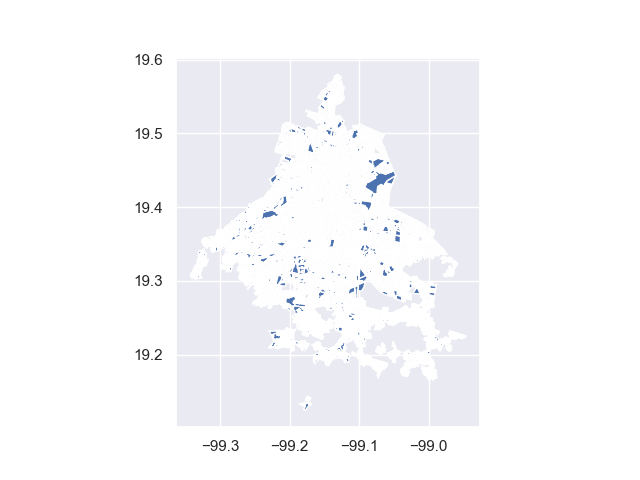

In [36]:
df_mza_clean.plot()

<AxesSubplot: >

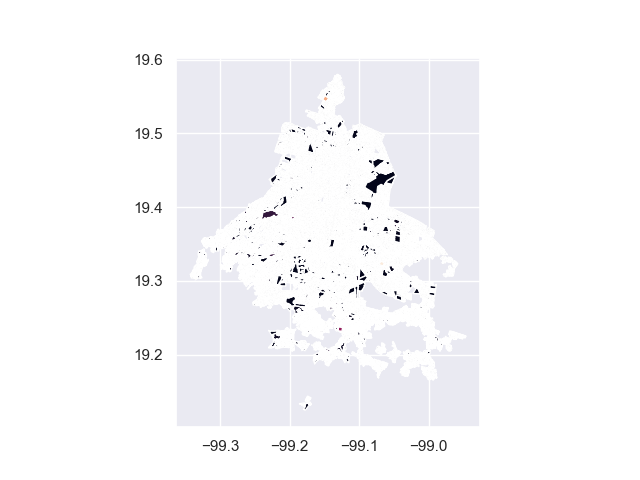

In [37]:
df_mza_clean.plot(column="P30A59A")

<AxesSubplot: >

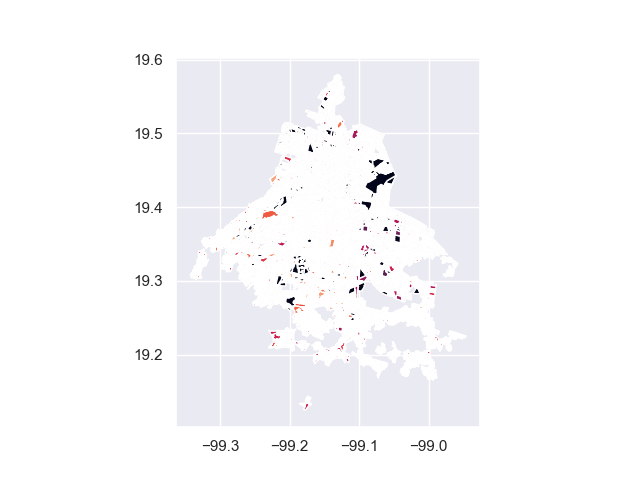

In [38]:
df_mza_clean.plot(column="GRAPROES")

<AxesSubplot: >

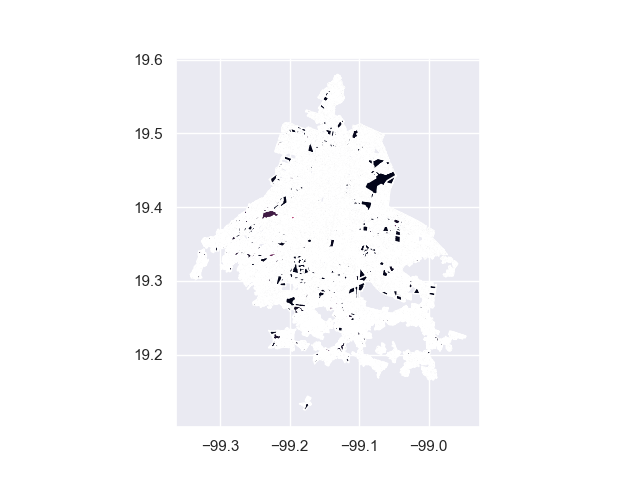

In [39]:
df_mza_clean.plot(column="TVIPAHAB")

## 2) Join : Manzanas en las colonias 

In [40]:
joined_df_mza_result = gpd.sjoin(
    df_mza_clean,
   df_col_43,
    how='inner',
    op='intersects',
)

In [41]:
joined_df_mza_result.head(2)

,P30A59A,GRAPROES,TVIPAHAB,geometry,index_right,NOMUT,ID
0,36.0,10.57,23.0,"POLYGON ((-99.22982 19.35939, -99.23058 19.358...",1655,HERON PROAL,1656
175,45.0,11.17,23.0,"POLYGON ((-99.23003 19.35814, -99.22992 19.358...",1655,HERON PROAL,1656


In [42]:
gouup_mza=joined_df_mza_result.groupby("ID").sum().reset_index()[["ID","P30A59A","TVIPAHAB"]]

In [43]:
gouup_mza.head(2)

,ID,P30A59A,TVIPAHAB
0,1,827.0,608.0
1,2,1589.0,1133.0


In [44]:
gouup_mza_mean=joined_df_mza_result.groupby("ID").mean().reset_index()[["ID","GRAPROES"]]

In [45]:
gouup_mza_mean.head(2)

,ID,GRAPROES
0,1,10.244000
1,2,10.845652


In [46]:
join_col_mer_mza= pd.merge(df_col_merc,gouup_mza, how="left", on="ID")

In [47]:
join_CMM_mean= pd.merge(join_col_mer_mza,gouup_mza_mean, how="left", on="ID")

In [48]:
join_CMM_mean.head(4)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652
2,ANGEL ZIMBRON,3,"POLYGON ((-99.19044 19.47144, -99.19031 19.471...",0,1137.0,867.0,10.765333
3,ARENAL,4,"POLYGON ((-99.15187 19.46803, -99.15186 19.468...",1,1748.0,1346.0,10.464286


Text(0.5, 1.0, 'Mercados por Colonias')

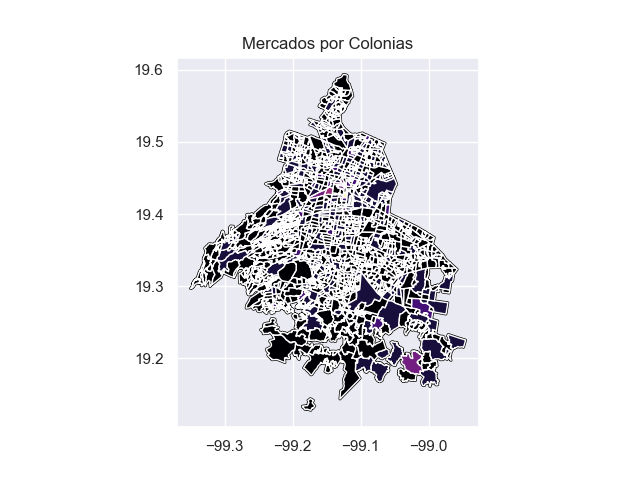

In [49]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
join_CMM_mean.plot(ax=ax,column="N_Mercados",cmap='magma', )
plt.title('Mercados por Colonias')

Text(0.5, 1.0, 'Población de 30 a 59 años')

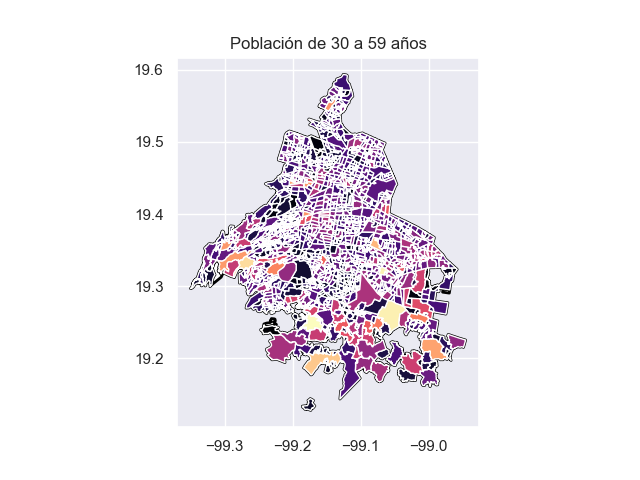

In [50]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
join_CMM_mean.plot(ax=ax,column="P30A59A",cmap='magma', )
plt.title('Población de 30 a 59 años')

Text(0.5, 1.0, 'Promedio de escolaridad por colonia')

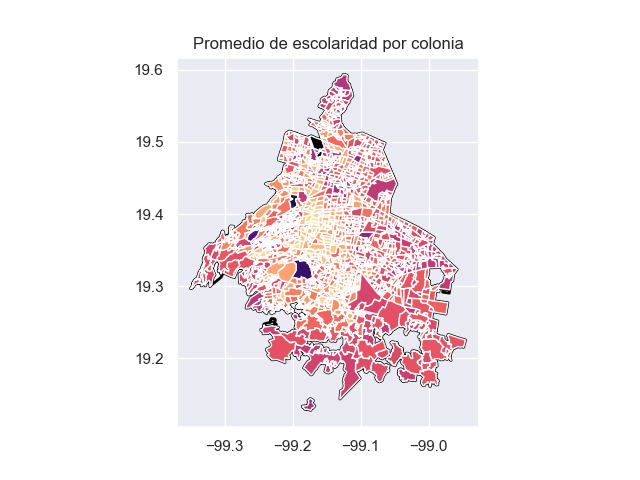

In [51]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
join_CMM_mean.plot(ax=ax,column="GRAPROES",cmap='magma', )
plt.title('Promedio de escolaridad por colonia')

Text(0.5, 1.0, 'Total de viviendas habitables por colonia')

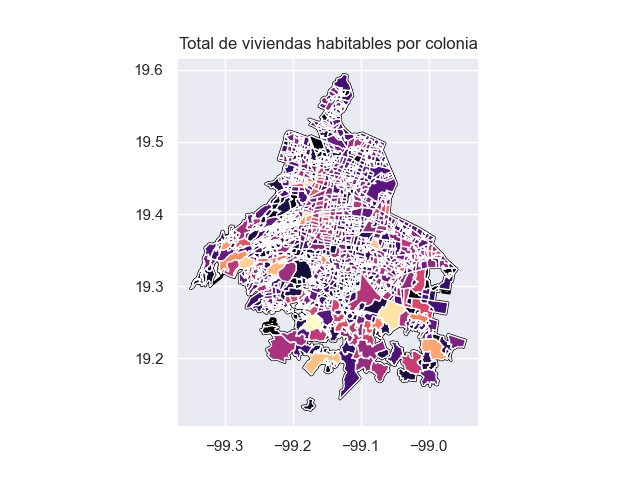

In [52]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
join_CMM_mean.plot(ax=ax,column="TVIPAHAB",cmap='magma', )
plt.title('Total de viviendas habitables por colonia')

# Data Tianguis

In [53]:
path_tig="data/Tianguis/ubicacin-de-tianguis.json"
df_tig = gpd.read_file(path_tig)

In [54]:
joi_tig_col= gpd.sjoin(
    df_tig,
    df_col_43,
    how='inner',
    op='intersects',
)

In [55]:
df_n_tianguis=joi_tig_col["ID"].value_counts().reset_index().rename(columns={"index":"ID","ID":"N_Tianguis"})

## 3) Join : Tianguis en Colonias

In [56]:
result_tig = pd.merge(join_CMM_mean, df_n_tianguis, how="left", on="ID")

In [57]:
result_tig ["N_Tianguis"]=result_tig ["N_Tianguis"].fillna(0)

In [58]:
result_tig.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0


Text(0.5, 1.0, 'Total Tianguis por colonia')

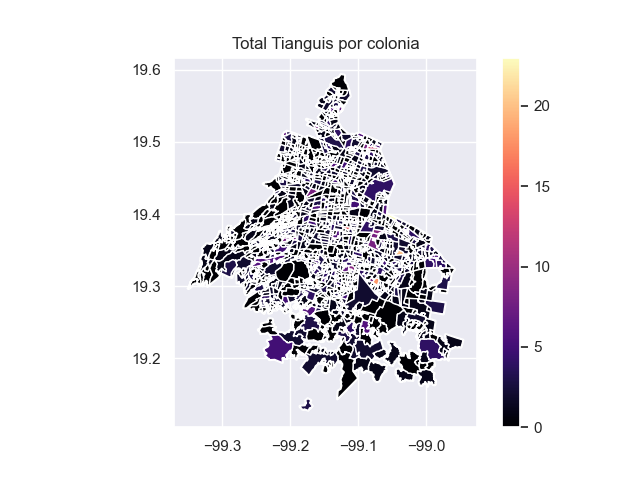

In [59]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='white')
result_tig .plot(ax=ax,column="N_Tianguis",cmap='magma',legend=True, )
plt.title('Total Tianguis por colonia')

# Data Concentración Habitacional 

In [60]:
path_conce="data/Alta_Concentración/alta_concentracion/zonas_vivienda.shp"
df_concen = gpd.read_file(path_conce)

In [61]:
# Cambiamos el formato 
df_concen=df_concen.to_crs(epsg=4326)

In [62]:
df_concen

,grado,ID,geometry
0,Muy baja concentración habitacional,1,"MULTIPOLYGON (((-99.07025 19.18079, -99.06992 ..."
1,Baja concentración habitacional,2,"MULTIPOLYGON (((-99.03187 19.18061, -99.02917 ..."
2,Media concentración habitacional,3,"MULTIPOLYGON (((-99.07120 19.18441, -99.07087 ..."
3,Alta concentración habitacional,4,"MULTIPOLYGON (((-99.08827 19.24682, -99.08707 ..."
4,Muy alta concentración habitacional,5,"MULTIPOLYGON (((-99.22984 19.27355, -99.23017 ..."


<AxesSubplot: >

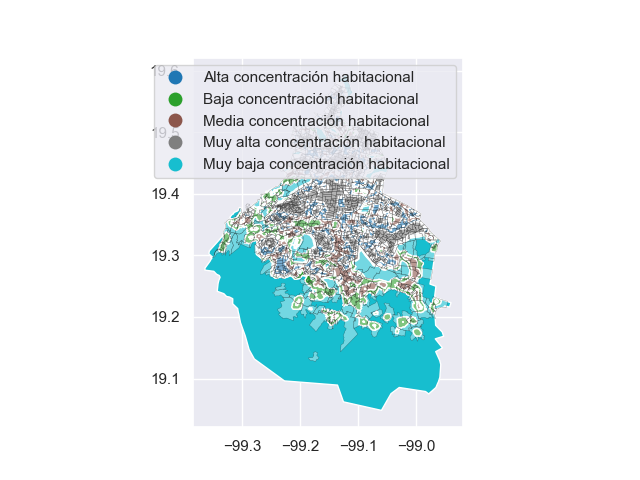

In [63]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_concen.plot(ax=ax, column="grado",legend=True,  alpha=1 )
df_col_43.plot(ax=ax, facecolor='grey', linewidth=0.3, color='white', edgecolor='black', alpha=0.4 )

In [64]:
joi_conce_col= gpd.sjoin(
    df_concen,
    df_col_43,
    how='inner',
    op='intersects',
)

In [65]:
joi_conce_col.head(10)

,grado,ID_left,geometry,index_right,NOMUT,ID_right
0,Muy baja concentración habitacional,1,"MULTIPOLYGON (((-99.07025 19.18079, -99.06992 ...",1530,SAN FRANCISCO TLALNEPANTLA (PBLO),1531
1,Baja concentración habitacional,2,"MULTIPOLYGON (((-99.03187 19.18061, -99.02917 ...",1530,SAN FRANCISCO TLALNEPANTLA (PBLO),1531
0,Muy baja concentración habitacional,1,"MULTIPOLYGON (((-99.07025 19.18079, -99.06992 ...",1523,SAN ANDRES AHUAYUCAN (PBLO),1524
1,Baja concentración habitacional,2,"MULTIPOLYGON (((-99.03187 19.18061, -99.02917 ...",1523,SAN ANDRES AHUAYUCAN (PBLO),1524
2,Media concentración habitacional,3,"MULTIPOLYGON (((-99.07120 19.18441, -99.07087 ...",1523,SAN ANDRES AHUAYUCAN (PBLO),1524
0,Muy baja concentración habitacional,1,"MULTIPOLYGON (((-99.07025 19.18079, -99.06992 ...",1506,LA CONCHA,1507
1,Baja concentración habitacional,2,"MULTIPOLYGON (((-99.03187 19.18061, -99.02917 ...",1506,LA CONCHA,1507
2,Media concentración habitacional,3,"MULTIPOLYGON (((-99.07120 19.18441, -99.07087 ...",1506,LA CONCHA,1507
0,Muy baja concentración habitacional,1,"MULTIPOLYGON (((-99.07025 19.18079, -99.06992 ...",1174,SAN SALVADOR CUAUHTENCO (PBLO),1175
1,Baja concentración habitacional,2,"MULTIPOLYGON (((-99.03187 19.18061, -99.02917 ...",1174,SAN SALVADOR CUAUHTENCO (PBLO),1175


# Data comerciantes

In [66]:
path_comerci="data/Comerciantes/comerciantes.json"
df_comerci = gpd.read_file(path_comerci)

In [67]:
df_comerci.head(2)

,CONS_SEDEC,CENTRO_DE,ALCALDÍA,MERCADO,NUM_OF,DIRECCION,COORD_X,COORD_Y,OBSERVACI,F10,F11,geometry
0,1.0,Concentración de comerciantes,Álvaro Obregón,Ampliación La Mexicana o Plaza La Mexicana,1.0,Av. Vasco de Quiroga entre Paso de la Nieve y ...,475793.99,2143328.64,None,None,None,POINT (-99.23052 19.38396)
1,2.0,Concentración de comerciantes,Álvaro Obregón,Ampliación Aguilas,2.0,Calz. Las Aguilas y Cda. Tarango col. Ampliaci...,0.00,0.00,None,None,None,None


In [68]:
joi_comer_col= gpd.sjoin(
    df_comerci,
    df_col_43,
    how='inner',
    op='intersects',
)

In [69]:
joi_comer_col.head(2)

,CONS_SEDEC,CENTRO_DE,ALCALDÍA,MERCADO,NUM_OF,DIRECCION,COORD_X,COORD_Y,OBSERVACI,F10,F11,geometry,index_right,NOMUT,ID
0,1.0,Concentración de comerciantes,Álvaro Obregón,Ampliación La Mexicana o Plaza La Mexicana,1.0,Av. Vasco de Quiroga entre Paso de la Nieve y ...,475793.99,2143328.64,None,None,None,POINT (-99.23052 19.38396),1676,LA MEXICANA,1677
2,3.0,Concentración de comerciantes,Álvaro Obregón,Barrio Norte,3.0,Mina de Platino entre Av. Benito Juárez y Av. ...,478178.72,2142767.43,None,None,None,POINT (-99.20780 19.37891),1592,BARRIO NORTE,1593


In [70]:
df_n_comerci=joi_comer_col["ID"].value_counts().reset_index().rename(columns={"index":"ID","ID":"N_Comerci"})

In [71]:
df_n_comerci.head(2)

,ID,N_Comerci
0,389,5
1,962,4


## 4) Join : Comerciantes en Colonias

In [72]:
result_comerci = pd.merge(result_tig , df_n_comerci, how="left", on="ID")

In [73]:
result_comerci ["N_Comerci"]=result_comerci["N_Comerci"].fillna(0)

In [74]:
result_comerci.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0


Text(0.5, 1.0, 'Total Comerciantes por colonia')

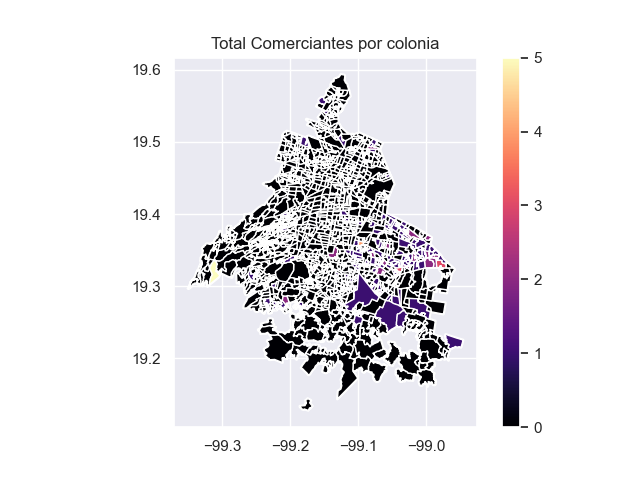

In [75]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='white')
result_comerci.plot(ax=ax,column="N_Comerci",cmap='magma',legend=True, )
plt.title('Total Comerciantes por colonia')

# Data Concentración de Empleo

In [76]:
path_empleo="data/Concentracion_de_empleo/concentracion_empleo/due_empleo_polygon.shp"
df_empleo = gpd.read_file(path_empleo)

In [77]:
# Cambiamos el formato 
df_empleo =df_empleo .to_crs(epsg=4326)

In [78]:
df_empleo 

,VALUE,geometry
0,3.0,"MULTIPOLYGON (((-99.08049 19.36084, -99.08049 ..."
1,4.0,"MULTIPOLYGON (((-99.20230 19.30291, -99.20230 ..."
2,5.0,"MULTIPOLYGON (((-99.10524 19.34998, -99.10619 ..."
3,1.0,"MULTIPOLYGON (((-98.99956 19.20541, -98.99956 ..."
4,2.0,"MULTIPOLYGON (((-99.07571 19.31385, -99.07571 ..."


<AxesSubplot: >

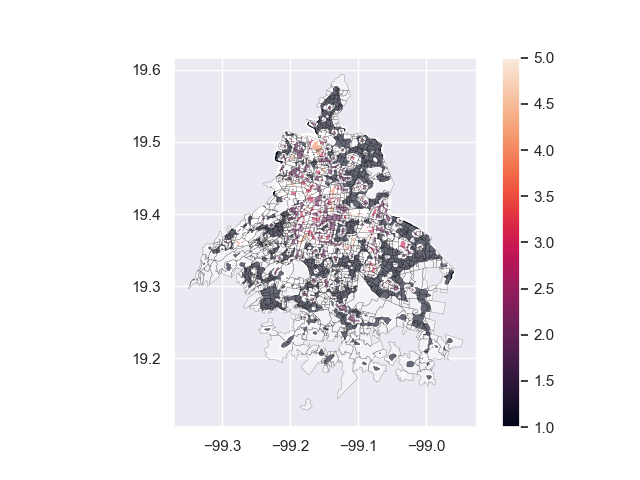

In [79]:
# Setup figure and axis
f, ax = plt.subplots(1)
# Add a layer with polygons on to axis `ax`
df_empleo.plot(ax=ax, column="VALUE",legend=True,  alpha=1 )
df_col_43.plot(ax=ax, facecolor='grey', linewidth=0.3, color='white', edgecolor='black', alpha=0.4 )

In [80]:
joi_empleo_col= gpd.sjoin(
    df_empleo,
    df_col_43,
    how='inner',
    op='intersects',
)

In [81]:
joi_empleo_col.head(2)

,VALUE,geometry,index_right,NOMUT,ID
0,3.0,"MULTIPOLYGON (((-99.08049 19.36084, -99.08049 ...",264,EL MIRADOR,265
3,1.0,"MULTIPOLYGON (((-98.99956 19.20541, -98.99956 ...",264,EL MIRADOR,265


# Data  Concentración Patrimonial

In [82]:
path_patri="data/Concentracion_Patrimonial/Áreas_de_conservación_patrimonial.shp"
df_patri = gpd.read_file(path_patri)

<AxesSubplot: >

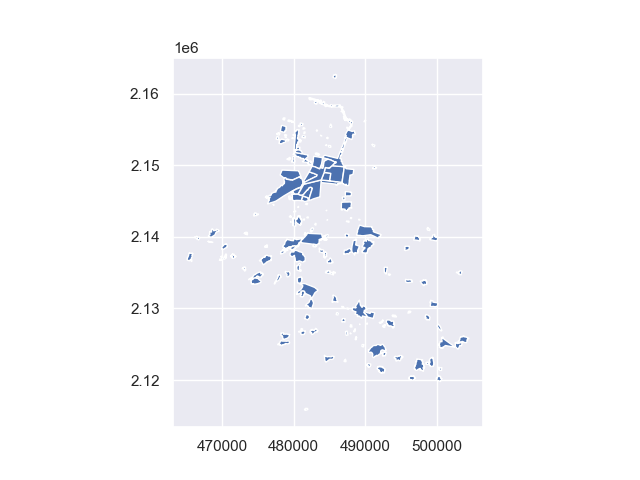

In [83]:
df_patri.plot()

In [84]:
# Cambiamos el formato 
def count_df(path,subfi,last_df):
    subfi=subfi
    df_patri = gpd.read_file(path)
    df_patri =df_patri.to_crs(epsg=4326)
    try:
        df_patri=df_patri.drop(columns=["ID"])
    except:
        pass
    joi_patri_col= gpd.sjoin(
        df_patri,
        df_col_43,
        how='inner',
        op='intersects',
    )
    # df_patri.plot()
    # plt.show()
    # display(joi_patri_col.head(2))
    df_n_prati=joi_patri_col["ID"].value_counts().reset_index().rename(columns={"index":"ID","ID":f"N_{subfi}"})
    result= pd.merge(last_df ,df_n_prati, how="left", on="ID")
    result[f"N_{subfi}"]=result[f"N_{subfi}"].fillna(0)

    return  result

result_patri=count_df(path=path_patri, subfi="Patri", last_df=result_comerci)

In [85]:
result_patri.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0


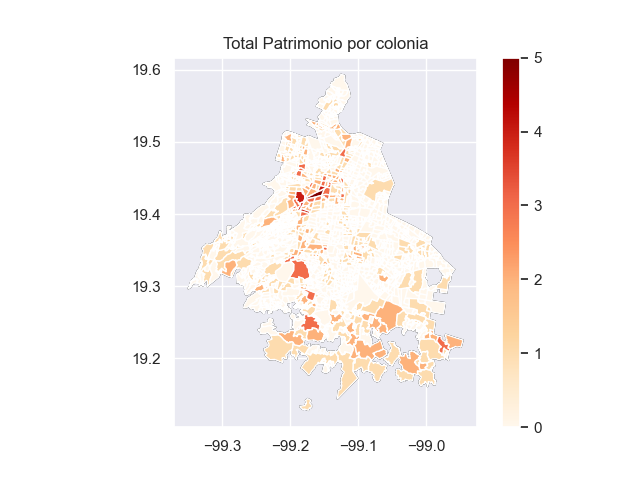

In [86]:
def plot_result(df_result,tipo,colum):
    f, ax = plt.subplots(1)
    df_col_43.plot(ax=ax, facecolor='grey', linewidth=1, color='white', edgecolor='black')
    df_result.plot(ax=ax,column=colum,cmap='OrRd',legend=True, )
    plt.title(f'Total {tipo} por colonia')
    plt.show()
plot_result(df_result=result_patri,tipo="Patrimonio",colum="N_Patri")

# Data Plazas Publicas

,geografico,ID,geometry
0,Plaza,1.0,"POLYGON ((488315.927 2136007.093, 488381.221 2..."
1,Plaza,2.0,"POLYGON ((485525.160 2161042.377, 485511.222 2..."
2,Plaza,3.0,"POLYGON ((482641.999 2158397.148, 482679.804 2..."
3,Plaza,4.0,"POLYGON ((487332.302 2151785.853, 487344.967 2..."
4,Plaza,5.0,"POLYGON ((474397.699 2133858.782, 474424.164 2..."


48

<AxesSubplot: >

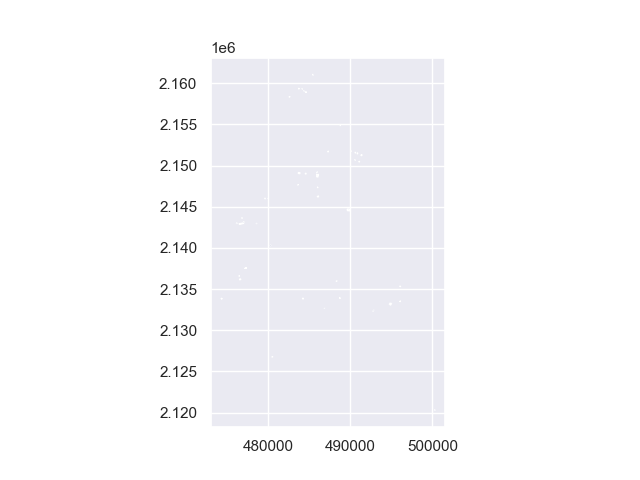

In [87]:
path_plz_public="data/Plazas_publicas/plazas-publicas-de-la-ciudad-de-mexico/Plazas_publicas_CDMX.shp"
df= gpd.read_file(path_plz_public)
display(df.head(),len(df))
df.plot()

In [88]:
result_plaza=count_df(path=path_plz_public, subfi="Plaza", last_df=result_patri)

In [89]:
result_plaza.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,N_Plaza
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,0.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,0.0


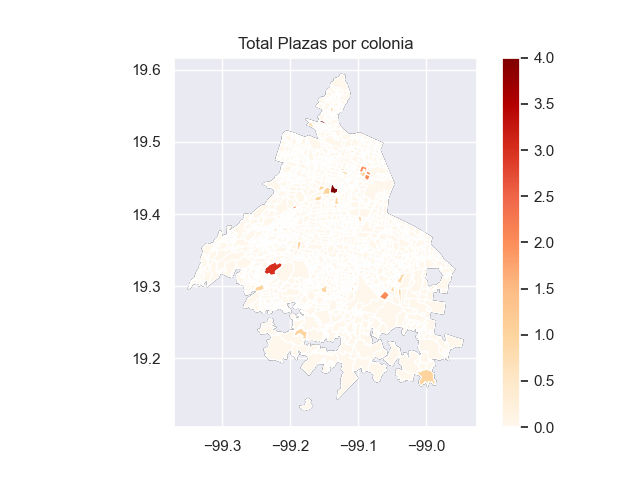

In [90]:
plot_result(df_result=result_plaza,tipo="Plazas",colum="N_Plaza")

# Data Unidades Economicas 

,ue,ind,com,serv,sup_ha,geometry,nombre
0,1960,37,500,1403,312.608615,"POLYGON ((-99.22017 19.42803, -99.22009 19.428...",LOMAS DE CHAPULTEPEC
1,27,0,7,7,78.368909,"POLYGON ((-99.22967 19.41406, -99.22970 19.413...",LOMAS DE REFORMA (LOMAS DE CHAPULTEPEC)
2,129,4,27,101,12.367361,"POLYGON ((-99.20821 19.43282, -99.20813 19.432...",DEL BOSQUE (POLANCO)
3,608,49,326,231,58.544747,"POLYGON ((-99.14587 19.31979, -99.14579 19.319...",PEDREGAL DE SANTA URSULA I
4,854,58,400,397,69.043070,"POLYGON ((-99.15854 19.33038, -99.15785 19.329...",AJUSCO I


1812

<AxesSubplot: >

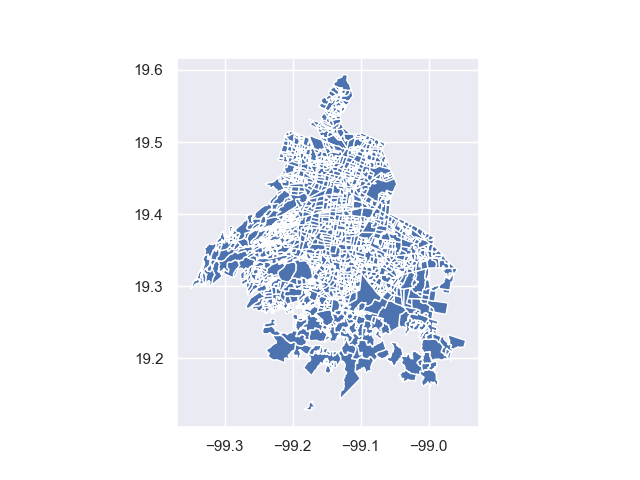

In [91]:
path_uniEco="data/Unidades_economicas/dnue_colonia/colonias_dnue.shp"
df_uniEco= gpd.read_file(path_uniEco)
selec_var_uniEco=["ue","ind","com","serv","sup_ha","geometry","nombre"]
df_uniEco=df_uniEco[selec_var_uniEco]
display(df_uniEco.head(),len(df_uniEco))
df_uniEco.plot()

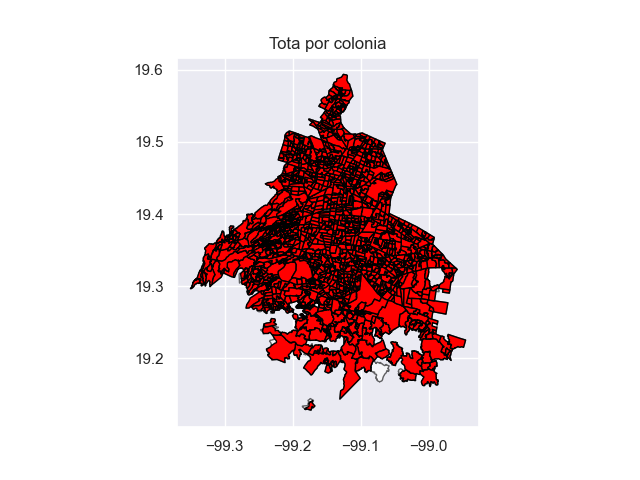

In [92]:
f, ax = plt.subplots(1)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=1, color='white', edgecolor='black',alpha=0.6)
df_uniEco.plot(ax=ax,linewidth=1, color='red', edgecolor='black' )
plt.title(f'Tota por colonia')
plt.show()

In [93]:
joi_uniEco_col= gpd.sjoin(
    df_uniEco,
    df_col_43,
    how='inner',
    op='intersects',
)

In [94]:
joi_uniEco_col.head(2)

,ue,ind,com,serv,sup_ha,geometry,nombre,index_right,NOMUT,ID
0,1960,37,500,1403,312.608615,"POLYGON ((-99.22017 19.42803, -99.22009 19.428...",LOMAS DE CHAPULTEPEC,1120,LOMAS DE REFORMA (LOMAS DE CHAPULTEPEC),1121
1,27,0,7,7,78.368909,"POLYGON ((-99.22967 19.41406, -99.22970 19.413...",LOMAS DE REFORMA (LOMAS DE CHAPULTEPEC),1120,LOMAS DE REFORMA (LOMAS DE CHAPULTEPEC),1121


In [95]:
group_uniEco=joi_uniEco_col.groupby("ID").sum().reset_index()[["ID","ue","ind","com","serv","sup_ha"]]

In [96]:
resul_uniEco= pd.merge(result_plaza,group_uniEco, how="left", on="ID")

In [97]:
resul_uniEco.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,N_Plaza,ue,ind,com,serv,sup_ha
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,0.0,422,55,191,173,64.508947
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,0.0,370,30,179,177,46.174779


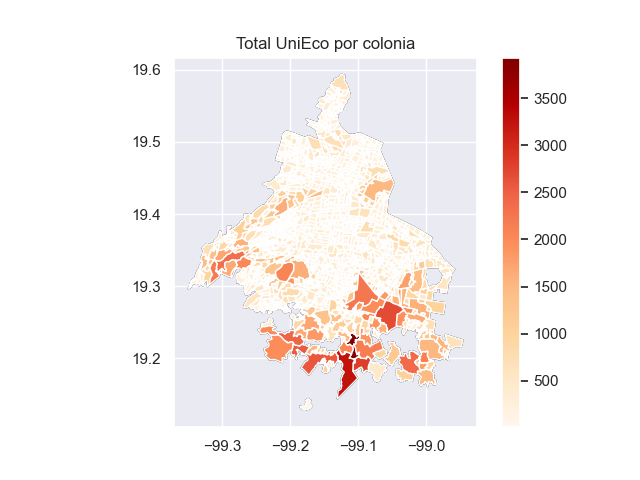

In [98]:
plot_result(df_result=resul_uniEco,tipo="UniEco",colum="sup_ha")

# Data Tasa de Crecimiento

In [99]:
path_Tcre="data/Tasa_de_crecimiento/tasa_crecimiento_medio/tcma10_20.shp"
df_Tcre= gpd.read_file(path_Tcre)
selec_var_Tcre=["PobTot2010","PobTot2020","DenPob10","DenPob20","colonia","geometry"]
df_Tcre=df_Tcre[selec_var_Tcre]
df_Tcre=df_Tcre.to_crs(epsg=4326)
display(df_Tcre.head(),len(df_uniEco))

,PobTot2010,PobTot2020,DenPob10,DenPob20,colonia,geometry
0,2014,1957,193.987675,188.497458,AGUILERA,"POLYGON ((-99.15901 19.47374, -99.15882 19.473..."
1,3537,3670,228.479544,237.070944,ALDANA,"POLYGON ((-99.14858 19.47156, -99.14863 19.471..."
2,2737,2330,112.995046,96.192348,ANGEL ZIMBRON,"POLYGON ((-99.18794 19.46458, -99.18800 19.463..."
3,4817,4306,168.388788,150.525663,ARENAL,"POLYGON ((-99.15187 19.46803, -99.15186 19.468..."
4,3043,3164,71.691909,74.542622,CENTRO DE AZCAPOTZALCO,"POLYGON ((-99.18959 19.48519, -99.18946 19.485..."


1812

In [100]:
df_Tcre["colonia"].value_counts()

LA JOYA                    4
MIGUEL HIDALGO             4
LA ASUNCION (BARR)         3
FRANCISCO VILLA            3
LA JOYITA                  3
                          ..
SAN JOSE TICOMAN           1
SAN JOSE DE LA ESCALERA    1
SAN FELIPE DE JESUS III    1
SAN FELIPE DE JESUS II     1
ZOTOLTITLA                 1
Name: colonia, Length: 1743, dtype: int64

<AxesSubplot: >

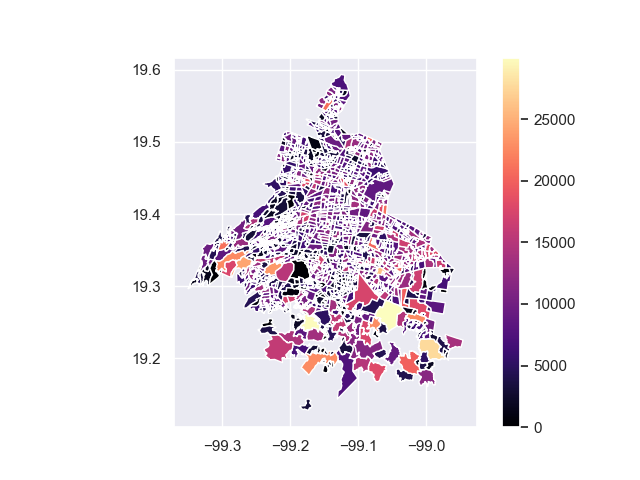

In [101]:
df_Tcre.plot(column="PobTot2020",cmap='magma',legend=True)

In [102]:
joi_Tcre_col= gpd.sjoin(
   df_Tcre,
    df_col_43,
    how='inner',
    op='intersects',
)

In [103]:
joi_Tcre_col.head(2)

,PobTot2010,PobTot2020,DenPob10,DenPob20,colonia,geometry,index_right,NOMUT,ID
0,2014,1957,193.987675,188.497458,AGUILERA,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",39,LIBERACION,40
1,3537,3670,228.479544,237.070944,ALDANA,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",39,LIBERACION,40


<AxesSubplot: >

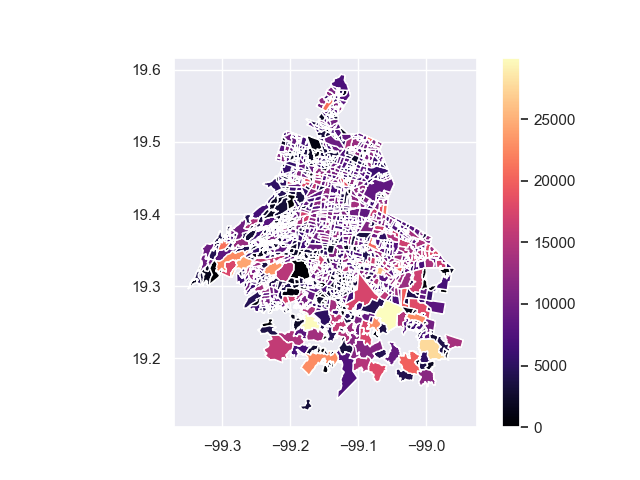

In [104]:
joi_Tcre_col.plot(column="PobTot2020",cmap='magma',legend=True)

In [105]:
group_densi=joi_Tcre_col.groupby("ID").sum().reset_index()[["ID","PobTot2010","PobTot2020","DenPob10","DenPob20"]]

In [106]:
group_densi.head(2)

,ID,PobTot2010,PobTot2020,DenPob10,DenPob20
0,1,22799,25858,1074.986969,1168.370900
1,2,12065,12211,1066.847315,1073.005356


In [107]:
group_densi["T_creci_Pobla"]=(group_densi["PobTot2020"]/group_densi["PobTot2010"] -1 )*100

In [108]:
group_densi["T_creci_Densi"]=(group_densi["DenPob20"]/group_densi["DenPob10"] -1 )*100

In [109]:
group_densi.head(2)

,ID,PobTot2010,PobTot2020,DenPob10,DenPob20,T_creci_Pobla,T_creci_Densi
0,1,22799,25858,1074.986969,1168.370900,13.417255,8.686983
1,2,12065,12211,1066.847315,1073.005356,1.210112,0.577219


In [110]:
group_densi_selec=group_densi[["ID","T_creci_Pobla","T_creci_Densi"]]

In [111]:
group_densi_selec.head(2)

,ID,T_creci_Pobla,T_creci_Densi
0,1,13.417255,8.686983
1,2,1.210112,0.577219


In [112]:
resul_PDensi= pd.merge(resul_uniEco,group_densi_selec, how="left", on="ID")

In [113]:
resul_PDensi.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,N_Plaza,ue,ind,com,serv,sup_ha,T_creci_Pobla,T_creci_Densi
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,0.0,422,55,191,173,64.508947,13.417255,8.686983
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,0.0,370,30,179,177,46.174779,1.210112,0.577219


# Data Centros Comerciales 

In [114]:
path_cco="data/centros_comerciales/C_PComerciales.shp"
df_cco= gpd.read_file(path_cco)
df_cco.head(2)
# selec_var_Tcre=["PobTot2010","PobTot2020","DenPob10","DenPob20","colonia","geometry"]
# df_Tcre=df_Tcre[selec_var_Tcre]
# df_Tcre=df_Tcre.to_crs(epsg=4326)
# display(df_Tcre.head(),len(df_uniEco))

,ID,TIPO,INSTITUCIO,CALLE,NUMERO,REFERENCIA,COLONIA,C_P_,Observacio,Alcaldía,geometry
0,1.0,TIENDAS DEPARTAMENTALES,"SANBORNS HERMANOS, S.A DE C.V.",Insurgentes Sur,2105,None,Sn. Angel,01000,None,Álvaro Obregón,POINT (480252.031 2139217.305)
1,2.0,TIENDAS DEPARTAMENTALES,Electra,Dr. Galvez,31,Esq. Revolución,Sn. Angel,01000,None,Álvaro Obregón,POINT (479974.338 2138843.603)


<AxesSubplot: >

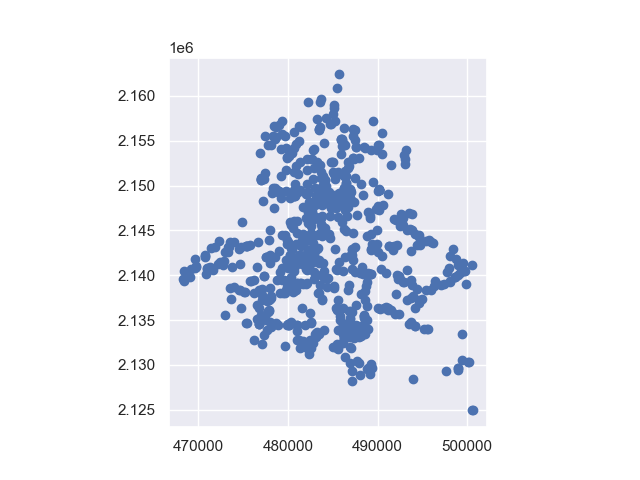

In [115]:
df_cco.plot()

In [116]:
result_ceco=count_df(path=path_cco, subfi="CeCo", last_df=resul_PDensi)

In [117]:
result_ceco.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,N_Plaza,ue,ind,com,serv,sup_ha,T_creci_Pobla,T_creci_Densi,N_CeCo
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,0.0,422,55,191,173,64.508947,13.417255,8.686983,0.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,0.0,370,30,179,177,46.174779,1.210112,0.577219,0.0


# Datos Nivel de Ingresos  Hogares

In [118]:
path_ingre="data/nivel_ingre_hoga/hex_ingresos_trimestrales/hex_ingresos_unidos.shp"
df_ingre= gpd.read_file(path_ingre)
display(df_ingre.head(2)),
len(df_ingre)

,id,clv_ingre,r_ingreso,geometry
0,1.0,1,"0 a 25,000","POLYGON ((479842.276 2114671.551, 480275.289 2..."
1,2.0,1,"0 a 25,000","POLYGON ((498028.810 2129671.551, 498461.823 2..."


39

In [119]:
df_ingre["clv_ingre"].value_counts()

1    15
3    10
2     7
4     5
5     2
Name: clv_ingre, dtype: int64

In [120]:
df_ingre["r_ingreso"].value_counts()

0 a 25,000           15
50,000 a 100,000     10
25,000 a 50,000       7
100,000 a 150,000     5
150,000 a 336,319     2
Name: r_ingreso, dtype: int64

In [121]:
selec_var_ingre=["clv_ingre","geometry"]
df_ingre=df_ingre[selec_var_ingre]
df_ingre=df_ingre.to_crs(epsg=4326)

<AxesSubplot: >

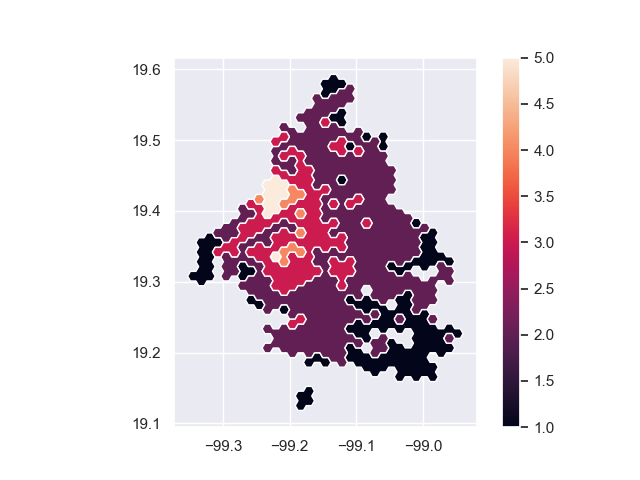

In [122]:
df_ingre.plot(column="clv_ingre",legend=True)

In [123]:
joi_ingre_col= gpd.sjoin(
   df_ingre,
    df_col_43,
    how='inner',
    op='intersects',
)

In [124]:
joi_ingre_col

,clv_ingre,geometry,index_right,NOMUT,ID
0,1,"POLYGON ((-99.19167 19.12502, -99.18756 19.131...",1276,PARRES EL GUARDA (PBLO),1277
1,1,"POLYGON ((-99.01876 19.26068, -99.01464 19.253...",1530,SAN FRANCISCO TLALNEPANTLA (PBLO),1531
15,2,"POLYGON ((-99.10135 19.55888, -99.10548 19.552...",1530,SAN FRANCISCO TLALNEPANTLA (PBLO),1531
1,1,"POLYGON ((-99.01876 19.26068, -99.01464 19.253...",1523,SAN ANDRES AHUAYUCAN (PBLO),1524
15,2,"POLYGON ((-99.10135 19.55888, -99.10548 19.552...",1523,SAN ANDRES AHUAYUCAN (PBLO),1524
...,...,...,...,...,...
34,4,"POLYGON ((-99.21664 19.32833, -99.21252 19.335...",311,OXTOPULCO UNIVERSIDAD,312
34,4,"POLYGON ((-99.21664 19.32833, -99.21252 19.335...",240,CHIMALISTAC,241
34,4,"POLYGON ((-99.21664 19.32833, -99.21252 19.335...",340,ROMERO DE TERREROS (COND),341
34,4,"POLYGON ((-99.21664 19.32833, -99.21252 19.335...",1769,SAN ANGEL INN,1770


<AxesSubplot: >

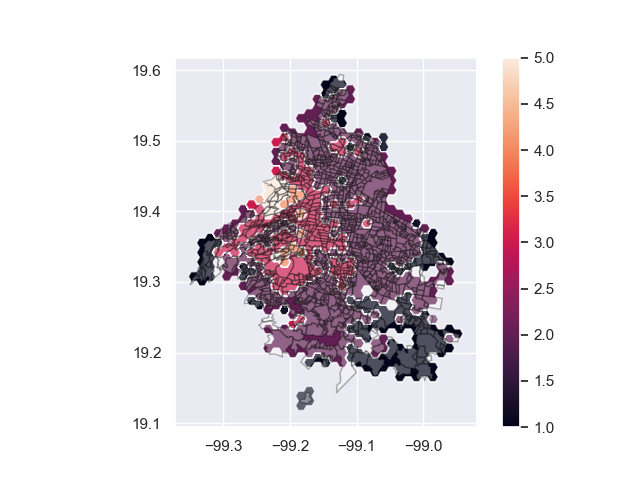

In [125]:
f, ax = plt.subplots(1)
joi_ingre_col.plot(ax=ax,column="clv_ingre",alpha=0.6,legend=True)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=1, color='white', edgecolor='black',alpha=0.3)


In [126]:
group_max_ingre=joi_ingre_col.groupby('ID').max().reset_index()[["ID","clv_ingre"]]

In [127]:
resul_ingre= pd.merge(result_ceco,group_max_ingre, how="left", on="ID")

<AxesSubplot: >

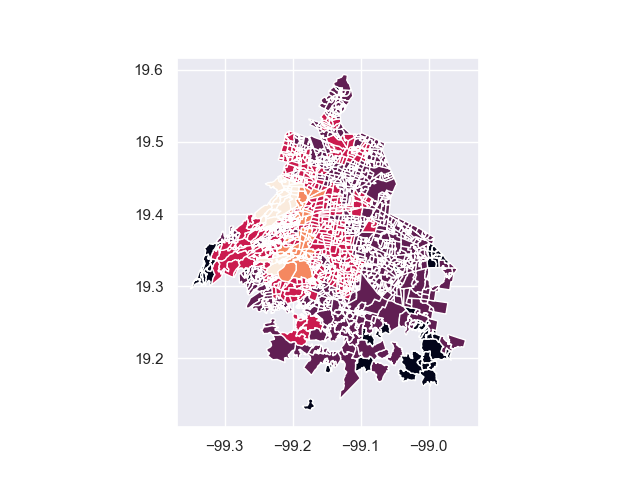

In [128]:
resul_ingre.plot("clv_ingre")

# Data Ingresos Promedio*

In [129]:
path_ingre_hex="data/nivel_ingresos_alto_med_bajo/potenciar_mezclas/hex_ingresos.shp"
df_ingre_hex= gpd.read_file(path_ingre_hex)
display(df_ingre_hex.head(2)),
len(df_ingre_hex)

,id,clv_ingre,r_ingreso,geometry
0,183.0,3,"50,000 a 100,000","POLYGON ((466851.895 2138671.551, 467284.908 2..."
1,223.0,3,"50,000 a 100,000","POLYGON ((468150.933 2139421.551, 468583.946 2..."


122

In [130]:
df_ingre_hex["clv_ingre"].value_counts()

3    100
4     11
5     11
Name: clv_ingre, dtype: int64

In [131]:
df_ingre_hex["r_ingreso"].value_counts()

50,000 a 100,000     100
100,000 a 150,000     11
150,000 a 336,319     10
150,000 a 336319       1
Name: r_ingreso, dtype: int64

In [132]:
selec_var_ingre_hex=["clv_ingre","geometry"]
df_ingre_hex=df_ingre_hex[selec_var_ingre_hex]
df_ingre_hex=df_ingre_hex.to_crs(epsg=4326)

<AxesSubplot: title={'center': 'Ingreso por hogar HEX'}>

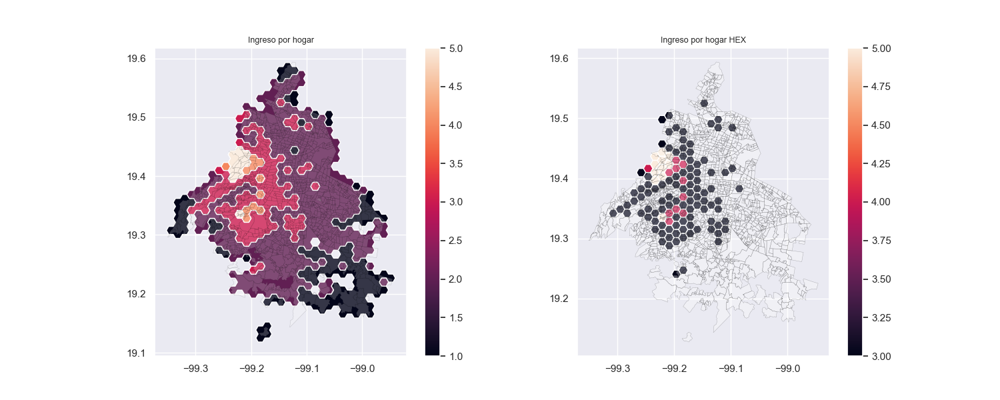

In [133]:
size_f=9
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(15, 6))

df_ingre.plot(ax=axes[0],column="clv_ingre",legend=True); axes[0].set_title('Ingreso por hogar',size=size_f)
df_col_43.plot(ax=axes[0], facecolor='grey', linewidth=0.3, color='white', edgecolor='black',alpha=.2)
df_ingre_hex.plot(ax=axes[1],column="clv_ingre",legend=True); axes[1].set_title('Ingreso por hogar HEX',size=size_f)
df_col_43.plot(ax=axes[1], facecolor='grey', linewidth=0.3, color='white', edgecolor='black',alpha=.3)

# Data Valor del Suelo

In [134]:
path_valueSue="data/valor_del_suelo/vus_promedio/valores_unitarios.shp"
df_valueSue= gpd.read_file(path_valueSue)
display(df_valueSue.head(2)),
len(df_valueSue)

,Id,RANGOS,VALOR,geometry
0,1,Muy bajo,"415 - 1,367","MULTIPOLYGON (((492608.103 2121052.403, 492048..."
1,2,Bajo,"1,368 - 2,335","MULTIPOLYGON (((487285.261 2128075.245, 487248..."


5

<AxesSubplot: >

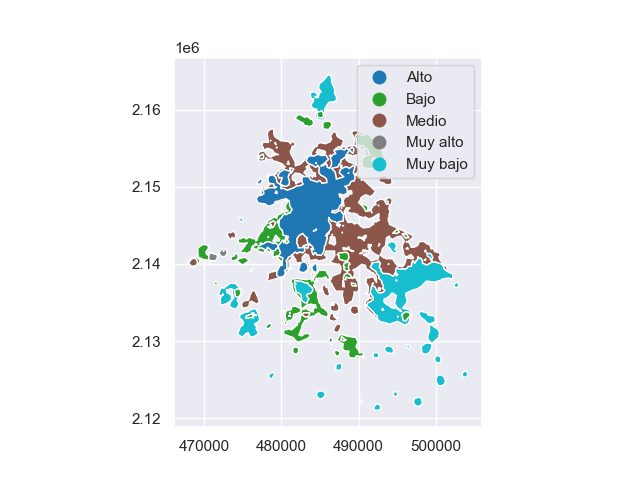

In [135]:
df_valueSue.plot(column="RANGOS",legend=True)

In [136]:
df_valueSue["Id"].value_counts(),df_valueSue["RANGOS"].value_counts()

(1    1
 2    1
 3    1
 4    1
 5    1
 Name: Id, dtype: int64,
 Muy bajo    1
 Bajo        1
 Medio       1
 Alto        1
 Muy alto    1
 Name: RANGOS, dtype: int64)

In [137]:
selec_var_valueSue=["Id","geometry"]
df_valueSue=df_valueSue[selec_var_valueSue]
df_valueSue=df_valueSue.to_crs(epsg=4326)

<AxesSubplot: >

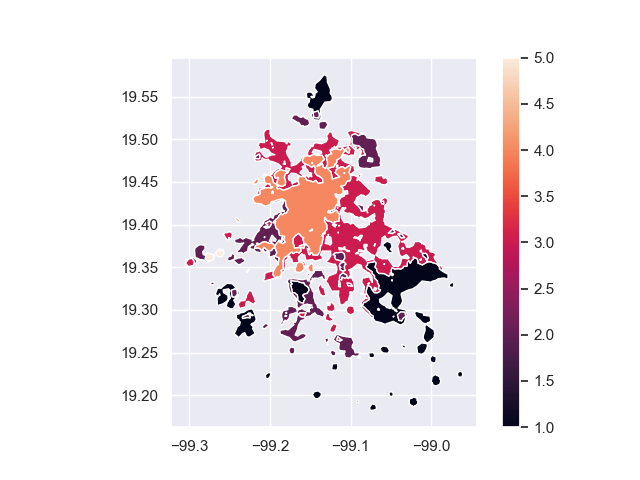

In [138]:
df_valueSue.plot(column="Id",legend=True)

In [139]:
joi_valueSue_col= gpd.sjoin(
   df_valueSue,
    df_col_43,
    how='inner',
    op='intersects',
)

In [140]:
joi_valueSue_col.head(2)

,Id,geometry,index_right,NOMUT,ID
0,1,"MULTIPOLYGON (((-99.07031 19.18277, -99.07563 ...",1552,SANTA INES,1553
0,1,"MULTIPOLYGON (((-99.07031 19.18277, -99.07563 ...",1541,SAN LUCAS XOCHIMANCA (PBLO),1542


<AxesSubplot: >

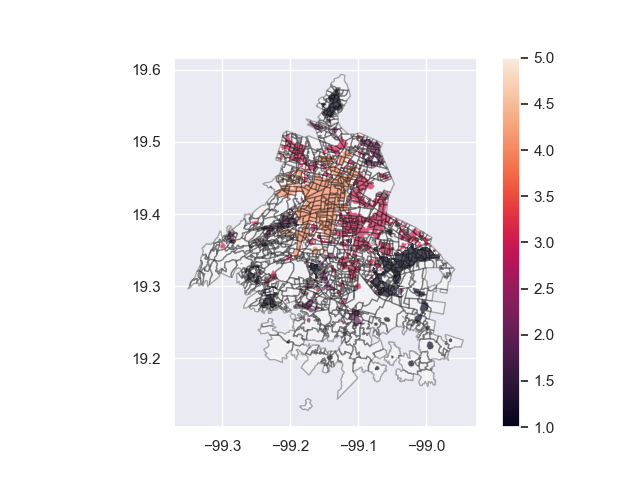

In [141]:
f, ax = plt.subplots(1)
joi_valueSue_col.plot(ax=ax,column="Id",alpha=0.6,legend=True)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=1, color='white', edgecolor='black',alpha=0.3)

In [142]:
group_max_valueSue=joi_valueSue_col.groupby('ID').max().reset_index()[["ID","Id"]]

In [143]:
group_max_valueSue.head(2)

,ID,Id
0,1,4
1,2,4


In [144]:
resul_valueSue= pd.merge(resul_ingre,group_max_valueSue, how="left", on="ID")

In [145]:
display(resul_valueSue.head(2)),len(resul_valueSue)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,...,ue,ind,com,serv,sup_ha,T_creci_Pobla,T_creci_Densi,N_CeCo,clv_ingre,Id
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,...,422,55,191,173,64.508947,13.417255,8.686983,0.0,2.0,4.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,...,370,30,179,177,46.174779,1.210112,0.577219,0.0,2.0,4.0


(None, 1815)

# Plot Total Map

In [146]:
result_plot=resul_valueSue

In [147]:
result_plot.head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,...,ue,ind,com,serv,sup_ha,T_creci_Pobla,T_creci_Densi,N_CeCo,clv_ingre,Id
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,...,422,55,191,173,64.508947,13.417255,8.686983,0.0,2.0,4.0
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,...,370,30,179,177,46.174779,1.210112,0.577219,0.0,2.0,4.0


In [148]:
result_plot=result_plot.dropna()

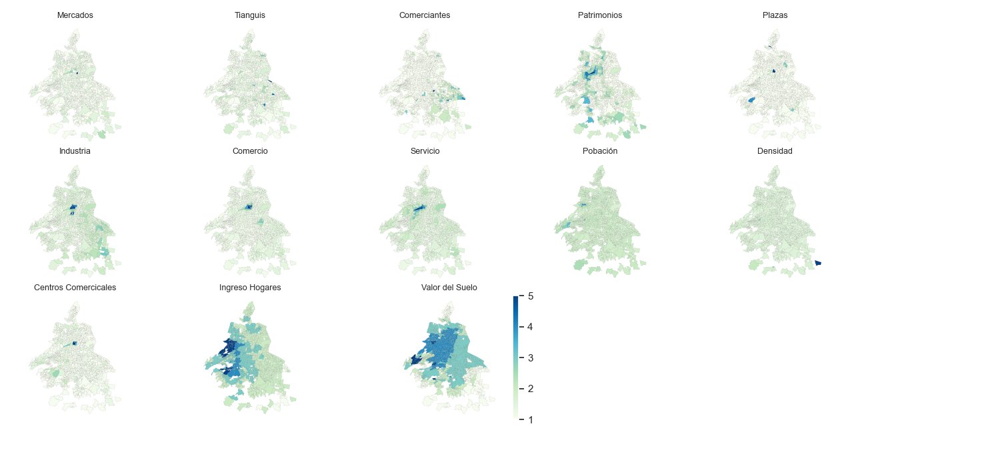

In [149]:
size_f=9
fig, axes = plt.subplots(nrows=3, ncols=5, figsize=(15, 7))

result_plot.plot(ax=axes[0,0],column="N_Mercados",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[0,0].set_title('Mercados',size=size_f)
result_plot.plot(ax=axes[0,1],column="N_Tianguis",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[0,1].set_title('Tianguis',size=size_f)
result_plot.plot(ax=axes[0,2],column="N_Comerci",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[0,2].set_title('Comerciantes',size=size_f)
result_plot.plot(ax=axes[0,3],column="N_Patri",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[0,3].set_title('Patrimonios',size=size_f)
result_plot.plot(ax=axes[0,4],column="N_Plaza",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[0,4].set_title('Plazas',size=size_f)

result_plot.plot(ax=axes[1,0],column="ind",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[1,0].set_title('Industria',size=size_f)
result_plot.plot(ax=axes[1,1],column="com",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[1,1].set_title('Comercio',size=size_f)
result_plot.plot(ax=axes[1,2],column="serv",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[1,2].set_title('Servicio',size=size_f)
result_plot.plot(ax=axes[1,3],column="T_creci_Pobla",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[1,3].set_title('Pobación',size=size_f)
result_plot.plot(ax=axes[1,4],column="T_creci_Densi",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[1,4].set_title('Densidad',size=size_f)
result_plot.plot(ax=axes[2,0],column="N_CeCo",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[2,0].set_title('Centros Comercicales',size=size_f)

result_plot.plot(ax=axes[2,1],column="clv_ingre",cmap='GnBu', linewidth=0.03, edgecolor='black'); axes[2,1].set_title('Ingreso Hogares',size=size_f)

result_plot.plot(ax=axes[2,2],column="Id",cmap='GnBu', linewidth=0.03, edgecolor='black',legend=True); axes[2,2].set_title('Valor del Suelo',size=size_f)

axes[0,0].set_axis_off()
axes[0,1].set_axis_off()
axes[0,2].set_axis_off()
axes[0,3].set_axis_off()
axes[0,4].set_axis_off()

axes[1,0].set_axis_off()
axes[1,1].set_axis_off()
axes[1,2].set_axis_off()
axes[1,3].set_axis_off()
axes[1,4].set_axis_off()

axes[2,0].set_axis_off()
axes[2,1].set_axis_off()
axes[2,2].set_axis_off()
axes[2,3].set_axis_off()
axes[2,4].set_axis_off()

plt.subplots_adjust(left=-0.05,
                    bottom=0.1,
                    right=0.9,
                    top=0.95,
                    wspace=-0.3,
                    hspace=0.1)
# plt.subplots_adjust(bottom=0.1, right=0.8, top=0.9)
# df['B'].plot(ax=axes[0,1]); axes[0,1].set_title('B')
# df['C'].plot(ax=axes[1,0]); axes[1,0].set_title('C')
# df['D'].plot(ax=axes[1,1]); axes[1,1].set_title('D')


# Datos Airbnb

In [150]:
df_airbnb_2021=pd.read_csv("data/Airbnb/listings_dec_2021.csv")

In [151]:
display(df_airbnb_2021.head(2)),len(df_airbnb_2021)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,35797,Villa Dante,153786,Dici,NaN,Cuajimalpa de Morelos,19.38283,-99.27178,Entire home/apt,4123,1,0,NaN,NaN,1,363,0,NaN
1,44616,CONDESA HAUS B&B,196253,Condesa Haus Bed & Breakfast CDMX,NaN,Cuauhtémoc,19.41162,-99.17794,Entire home/apt,15000,1,50,2021-08-23,0.41,10,344,1,NaN


(None, 19655)

In [152]:
gdf_airbnb_2021 = gpd.GeoDataFrame(
    df_airbnb_2021, geometry=gpd.points_from_xy(df_airbnb_2021.longitude, df_airbnb_2021.latitude))

In [153]:
gdf_airbnb_2021.head(2)

,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license,geometry
0,35797,Villa Dante,153786,Dici,NaN,Cuajimalpa de Morelos,19.38283,-99.27178,Entire home/apt,4123,1,0,NaN,NaN,1,363,0,NaN,POINT (-99.27178 19.38283)
1,44616,CONDESA HAUS B&B,196253,Condesa Haus Bed & Breakfast CDMX,NaN,Cuauhtémoc,19.41162,-99.17794,Entire home/apt,15000,1,50,2021-08-23,0.41,10,344,1,NaN,POINT (-99.17794 19.41162)


<AxesSubplot: >

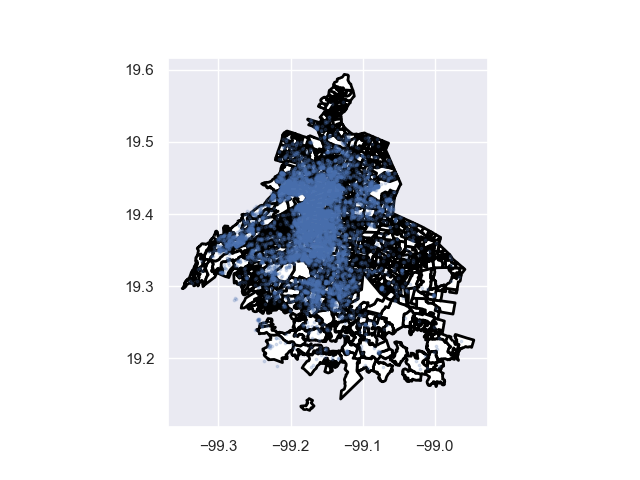

In [154]:
f, ax = plt.subplots(1)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=2, color='white', edgecolor='black')
gdf_airbnb_2021.plot(ax=ax,markersize=3, alpha=0.2)

In [155]:
gdf_airbnb_2021["room_type"].value_counts(normalize=True).reset_index()

,index,room_type
0,Entire home/apt,0.580412
1,Private room,0.395116
2,Shared room,0.014704
3,Hotel room,0.009769


In [156]:
color_map = colors.LinearSegmentedColormap.from_list('my_colormap', ['#5DA5DA', '#FAA43A', '#60BD68', '#F17CB0'])

In [157]:
color_map = colors.LinearSegmentedColormap.from_list('my_colormap', ['#5DA5DA', '#FAA43A', '#60BD68'])

<AxesSubplot: ylabel='room_type'>

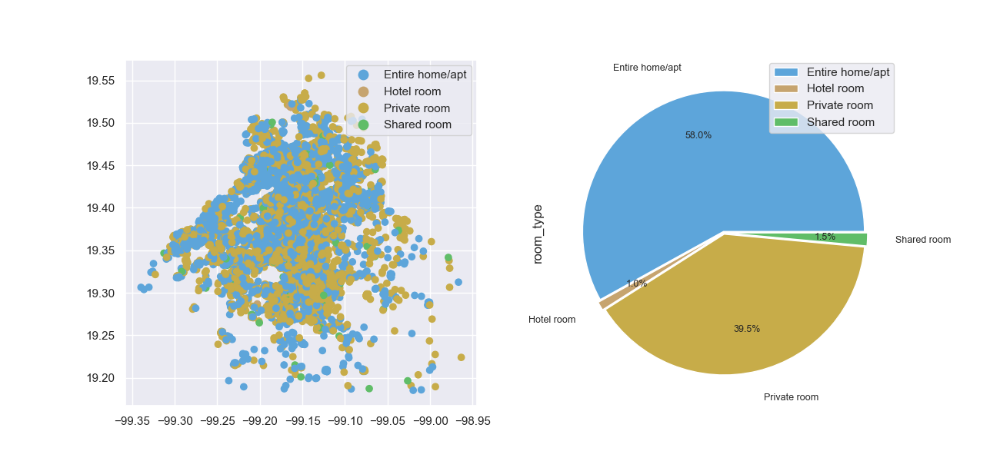

In [158]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(13, 6))
map_grad_col="inferno"

gdf_airbnb_2021.plot(ax=axes[0],column="room_type",legend=True,cmap=color_map  )

gdf_airbnb_2021["room_type"].value_counts(normalize=True).reset_index().groupby(['index']).sum().plot(
    ax=axes[1],kind='pie', y='room_type',cmap=color_map , autopct='%0.1f%%',
    # colors = ['red', 'pink', 'steelblue', 'steelblue'],
    textprops={'fontsize': 9},pctdistance=0.7,labeldistance=1.2, explode=(0.01,0.02,0.01,0.02))


In [159]:
# Datos 2022

In [160]:
df_airbnb_2022=pd.read_csv("data/Airbnb/listings_sep_2022.csv")

In [161]:
df_locations=df_airbnb_2022
gdf_airbnb_2022= gpd.GeoDataFrame(
   df_locations, geometry=gpd.points_from_xy(df_locations.longitude, df_locations.latitude))

In [162]:
for i in gdf_airbnb_2021["room_type"].unique():
    print(i)

Entire home/apt
Private room
Hotel room
Shared room


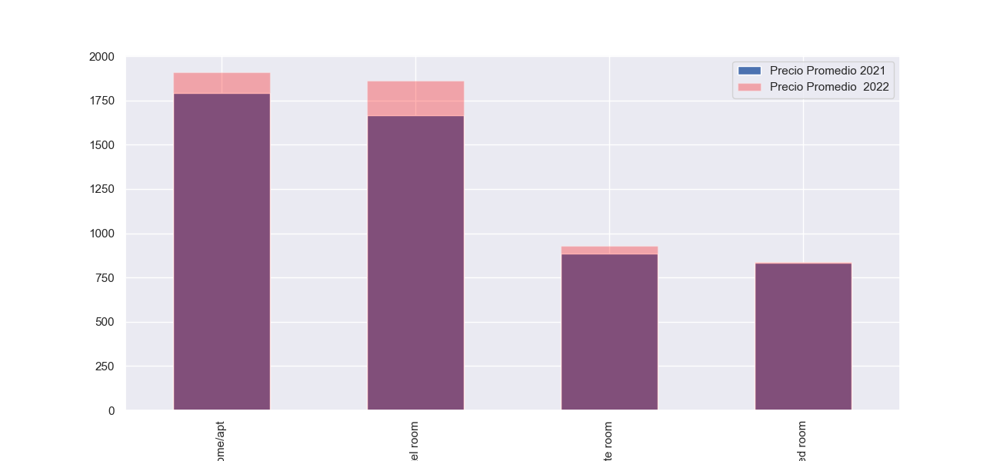

In [163]:
fig, axes = plt.subplots( figsize=(13, 6))
gdf_airbnb_2021.groupby("room_type").mean()[["price"]].plot.bar(ax=axes,alpha=1)
gdf_airbnb_2022.rename(columns={"Entire home/apt":"2022"}).groupby("room_type").mean()[["price"]].plot.bar(ax=axes,color="red",alpha=0.3)
axes.legend(labels=["Precio Promedio 2021","Precio Promedio  2022"])

In [164]:
joi_gdf_airbnb_2021_col= gpd.sjoin(
    gdf_airbnb_2021,
    df_col_43,
    how='inner',
    op='intersects',
)
joi_gdf_airbnb_2022_col= gpd.sjoin(
    gdf_airbnb_2022,
    df_col_43,
    how='inner',
    op='intersects',
)

<AxesSubplot: >

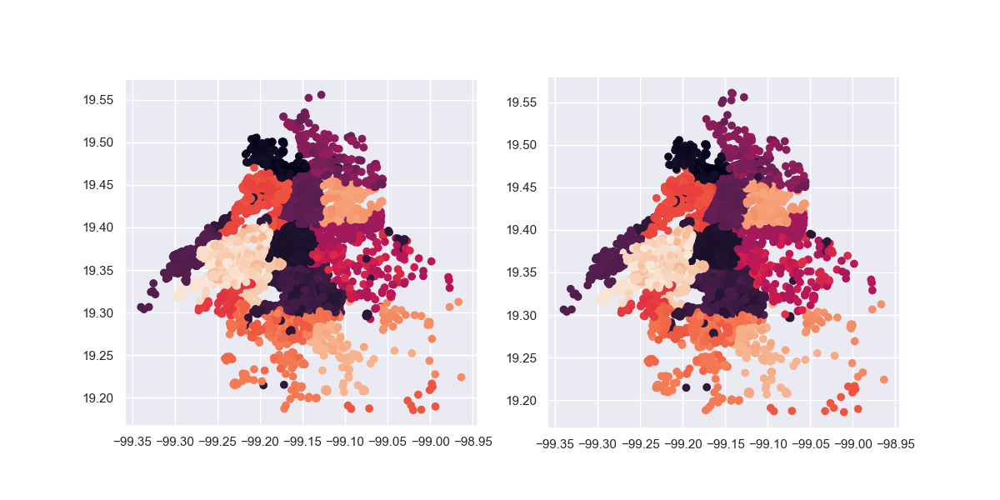

In [165]:
fig, axes=plt.subplots(nrows=1,ncols=2,figsize=(12,6))

joi_gdf_airbnb_2021_col.plot(ax=axes[0],column="ID")
joi_gdf_airbnb_2022_col.plot(ax=axes[1],column="ID")

<AxesSubplot: >

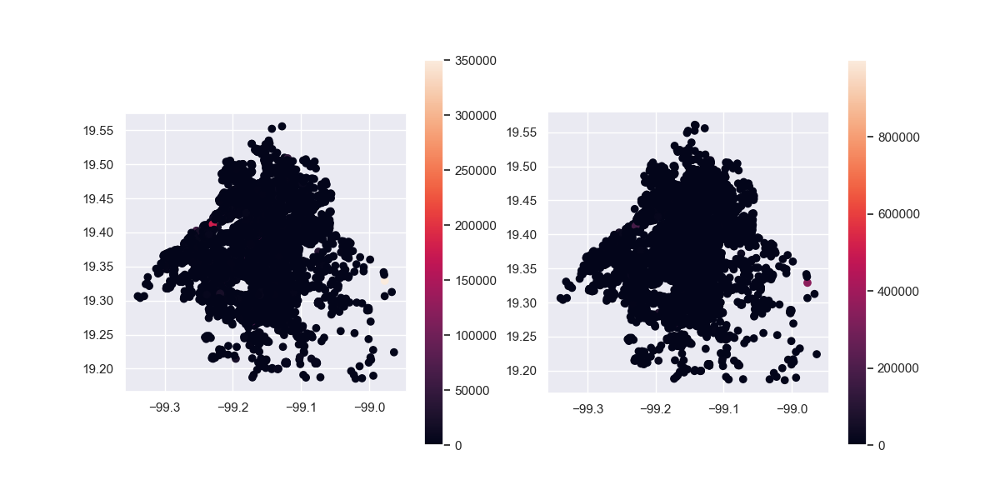

In [166]:
fig, axes=plt.subplots(nrows=1,ncols=2,figsize=(12,6))

joi_gdf_airbnb_2021_col.plot(ax=axes[0],column="price",legend=True)
joi_gdf_airbnb_2022_col.plot(ax=axes[1],column="price",legend=True)

<AxesSubplot: >

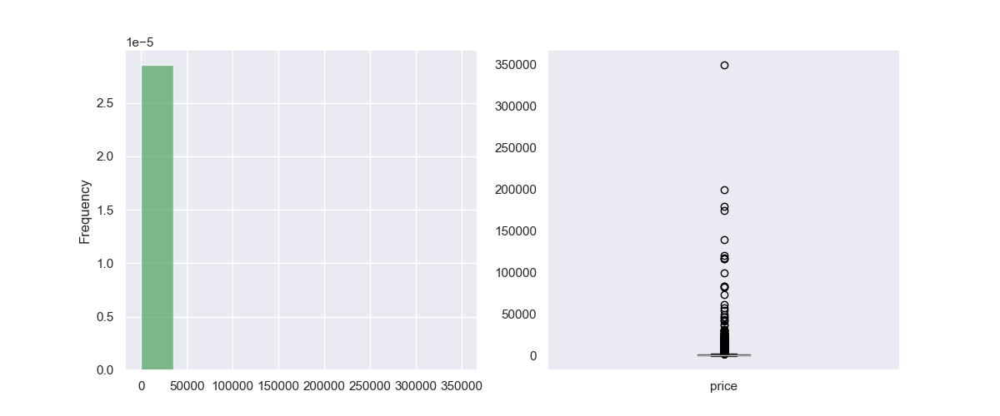

In [167]:
fig, axes = plt.subplots(nrows=1,ncols=2,figsize =(12, 5))

joi_gdf_airbnb_2021_col.price.plot.hist(ax=axes[0],density=True, facecolor='g', alpha=0.75)
joi_gdf_airbnb_2021_col.boxplot(ax=axes[1],column =['price'], grid = False)

<AxesSubplot: xlabel='room_type', ylabel='price'>

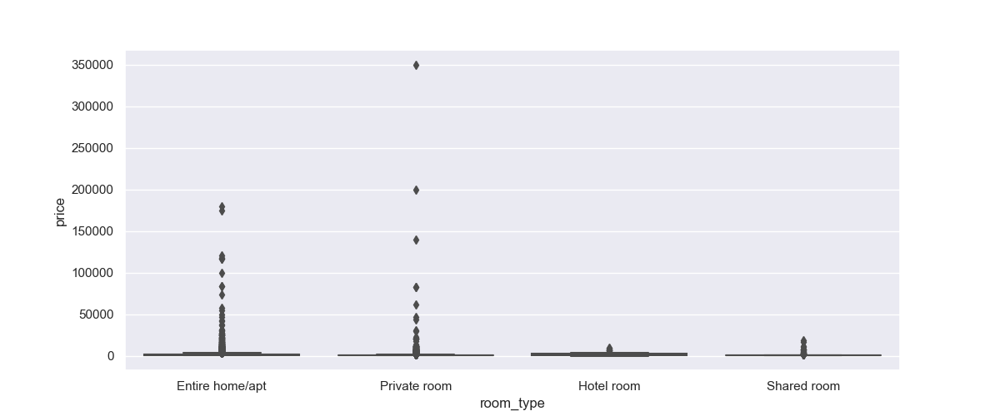

In [168]:
fig = plt.figure(figsize =(12, 5))
sns.boxplot(x="room_type", y='price', data=joi_gdf_airbnb_2021_col)

Text(0.5, 1.0, 'Price 2022')

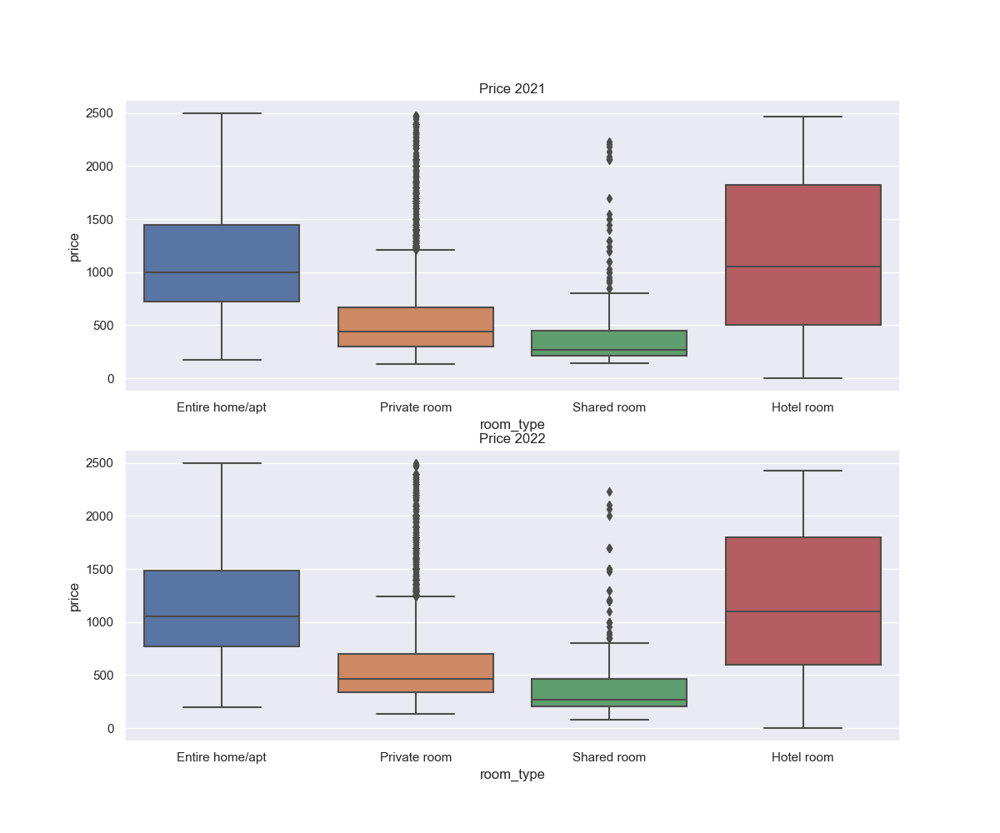

In [169]:
fig,axes = plt.subplots(nrows=2,ncols=1,figsize =(12, 10))
sns.boxplot(ax=axes[0],x="room_type", y='price', data=joi_gdf_airbnb_2021_col[joi_gdf_airbnb_2021_col.price<2500])
axes[0].set_title("Price 2021")
sns.boxplot(ax=axes[1],x="room_type", y='price', data=joi_gdf_airbnb_2022_col[joi_gdf_airbnb_2022_col.price<2500])
axes[1].set_title("Price 2022")

<AxesSubplot: >

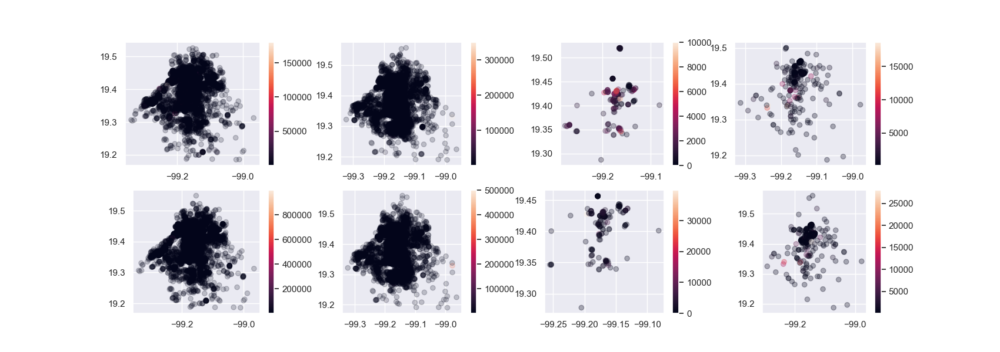

In [170]:

split_df_0=joi_gdf_airbnb_2021_col[joi_gdf_airbnb_2021_col["room_type"]=="Entire home/apt"]
split_df_1=joi_gdf_airbnb_2021_col[joi_gdf_airbnb_2021_col["room_type"]=="Private room"]
split_df_2=joi_gdf_airbnb_2021_col[joi_gdf_airbnb_2021_col["room_type"]=="Hotel room"]
split_df_3=joi_gdf_airbnb_2021_col[joi_gdf_airbnb_2021_col["room_type"]=="Shared room"]

split_df_00=joi_gdf_airbnb_2022_col[joi_gdf_airbnb_2022_col["room_type"]=="Entire home/apt"]
split_df_10=joi_gdf_airbnb_2022_col[joi_gdf_airbnb_2022_col["room_type"]=="Private room"]
split_df_20=joi_gdf_airbnb_2022_col[joi_gdf_airbnb_2022_col["room_type"]=="Hotel room"]
split_df_30=joi_gdf_airbnb_2022_col[joi_gdf_airbnb_2022_col["room_type"]=="Shared room"]

fig, axes=plt.subplots(nrows=2,ncols=4,figsize=(17,6))

split_df_0.plot(ax=axes[0,0],column="price",legend=True,alpha=0.2)
split_df_00.plot(ax=axes[1,0],column="price",legend=True,alpha=0.2)

split_df_1.plot(ax=axes[0,1],column="price",legend=True,alpha=0.2)
split_df_10.plot(ax=axes[1,1],column="price",legend=True,alpha=0.2)

split_df_2.plot(ax=axes[0,2],column="price",legend=True,alpha=0.3)
split_df_20.plot(ax=axes[1,2],column="price",legend=True,alpha=0.3)

split_df_3.plot(ax=axes[0,3],column="price",legend=True,alpha=0.3)
split_df_30.plot(ax=axes[1,3],column="price",legend=True,alpha=0.3)




In [171]:
last_df=resul_valueSue
for k in  gdf_airbnb_2021["room_type"].unique():

    subfi=k

    type_rent=k

    gdf_0=gdf_airbnb_2021
    gdf_2=gdf_airbnb_2022

    gdf_list=[gdf_0,gdf_2]

    tras_df=[]
    for i in gdf_list:
        room_type=i[i["room_type"]==type_rent]
        joi_room_type_col= gpd.sjoin(
            room_type,
            df_col_43,
            how='inner',
            op='intersects',
        )
        n_items=joi_room_type_col["ID"].value_counts().reset_index().rename(columns={"index":"ID","ID":f"N_{subfi}"})
        var_sel=joi_room_type_col.groupby("ID").mean().reset_index()[["ID","price","number_of_reviews","availability_365"]]
        result= pd.merge(n_items ,var_sel, how="left", on="ID")
        tras_df.append(result)

    # display(tras_df[0].info()),print("\n"), display(tras_df[1].info())
    group_densi["T_creci_Pobla"]=(group_densi["PobTot2020"]/group_densi["PobTot2010"] -1 )*100

    result_merge= pd.merge( tras_df[1],tras_df[0], how="left", on="ID")
    result_merge=result_merge.dropna()

    name_col_va_list=["ID"]
    for i in list(tras_df[0].drop(columns=["ID"]).columns):
        col_1=i+"_x"
        col_2=i+"_y"
        name_col_var=f"Tsa_{i}-{k}"
        name_col_va_list.append(name_col_var)
        result_merge[ name_col_var]= (result_merge[col_1]/result_merge[col_2] -1 )*100

    result_merge=result_merge[name_col_va_list]
    # display(result_merge)
    last_df = pd.merge(last_df , result_merge, how="left", on="ID")

last_df=last_df.fillna(0)
last_df.replace([np.inf, -np.inf], 0, inplace=True)

In [172]:
last_df.columns

Index(['NOMUT', 'ID', 'geometry', 'N_Mercados', 'P30A59A', 'TVIPAHAB',
       'GRAPROES', 'N_Tianguis', 'N_Comerci', 'N_Patri', 'N_Plaza', 'ue',
       'ind', 'com', 'serv', 'sup_ha', 'T_creci_Pobla', 'T_creci_Densi',
       'N_CeCo', 'clv_ingre', 'Id', 'Tsa_N_Entire home/apt-Entire home/apt',
       'Tsa_price-Entire home/apt', 'Tsa_number_of_reviews-Entire home/apt',
       'Tsa_availability_365-Entire home/apt',
       'Tsa_N_Private room-Private room', 'Tsa_price-Private room',
       'Tsa_number_of_reviews-Private room',
       'Tsa_availability_365-Private room', 'Tsa_N_Hotel room-Hotel room',
       'Tsa_price-Hotel room', 'Tsa_number_of_reviews-Hotel room',
       'Tsa_availability_365-Hotel room', 'Tsa_N_Shared room-Shared room',
       'Tsa_price-Shared room', 'Tsa_number_of_reviews-Shared room',
       'Tsa_availability_365-Shared room'],
      dtype='object')

<AxesSubplot: >

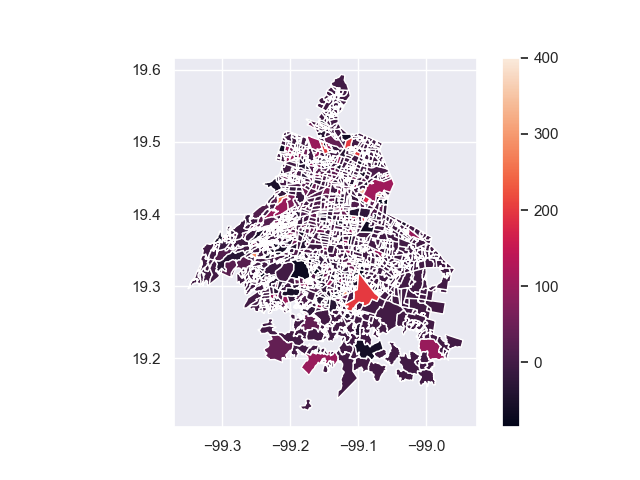

In [173]:
last_df.plot(column='Tsa_N_Private room-Private room',legend=True)

# Correlaciones

In [174]:
df_end=resul_valueSue

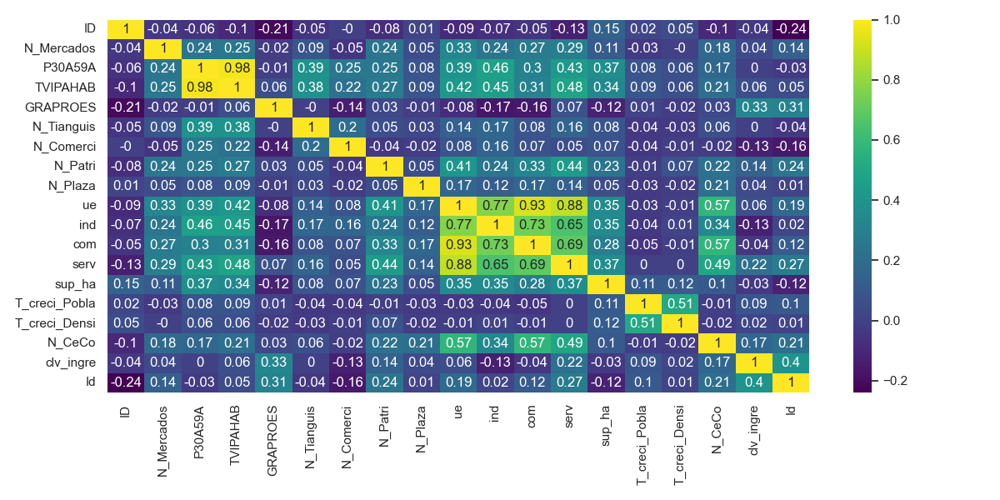

In [175]:
# 3 Correlations
corr_matrix = df_end.corr()
corr_matrix = np.round(corr_matrix, 2)
fig, ax = plt.subplots(figsize=(12, 6))
sns.heatmap(corr_matrix, annot=True, fmt="g", cmap='viridis', ax=ax)
            # xticklabels=kpis, yticklabels=kpis)
plt.tight_layout()
# fig.show()

In [176]:
df_end=df_end.dropna()

# Numero de Clusters 

In [177]:
def defin_cluster(df_end):
    df_end=df_end.dropna()
    x=df_end.drop(columns=["NOMUT","ID","geometry"])
    # 2 Normalize
    df2 = x.copy()
    # df2 = df2.drop(columns=['id_barrio', 'nom_barrio'])
    # display(df2)
    x = df2.values  # returns a numpy array
    scaler = preprocessing.StandardScaler()
    x_scaled = scaler.fit_transform(x)
    df2 = pd.DataFrame(x_scaled)
    # Inicializar vacío lista para almacenar las inercias
    inercias = []

    # Probar diferentes valores de k
    for k in range(1, 11):
        # Inicializar el modelo de k-means
        model = KMeans(n_clusters=k)
        # Ajustar el modelo a los datos
        model.fit(df2)
        # Almacenar la inercia
        inercias.append(model.inertia_)
    f, ax = plt.subplots(1)
    # Graficar el valor de la inercia en función de k
    plt.plot(range(1, 11), inercias, '-o')
    ax.set_xticks(range(0, 11, 1))
    ax.axvline(x=3, color='r')
    plt.xlabel('Número de clusters')
    plt.ylabel('Inercia')
    plt.show()
    

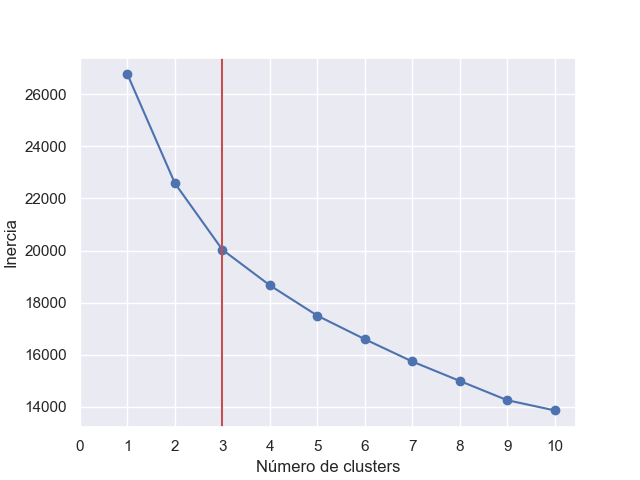

In [178]:
# Select features  
result_features=resul_valueSue
defin_cluster(df_end=result_features)

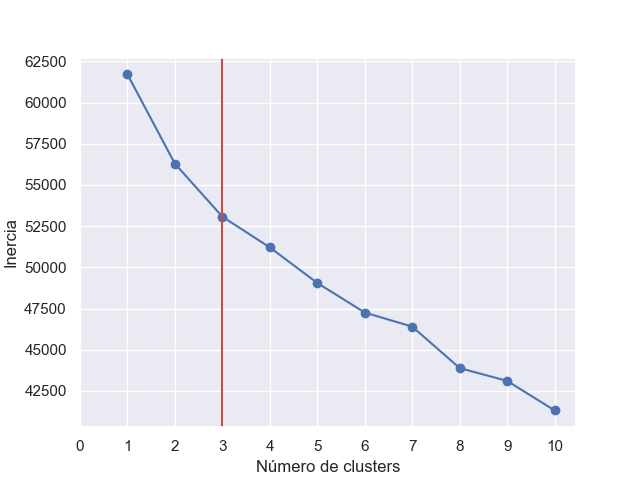

In [179]:
# Select features  
result_features=last_df
defin_cluster(df_end=result_features)

# Modelo Kmeans

In [180]:
def model_ubi(df_end,model="Kmeans"):
    df_end=df_end.dropna()
    x=df_end.drop(columns=["NOMUT","ID","geometry"])
    # 2 Normalize
    df2 = x.copy()
    # df2 = df2.drop(columns=['id_barrio', 'nom_barrio'])
    # display(df2)
    x = df2.values  # returns a numpy array
    scaler = preprocessing.StandardScaler()
    x_scaled = scaler.fit_transform(x)
    df2 = pd.DataFrame(x_scaled)
    
    if model=="Kmeans":
        kmeans = KMeans(n_clusters=3, random_state=0)
        kmeans.fit(df2)
        df_end["Predict"]=kmeans.labels_
    
    elif model=="hc":
        hc = AgglomerativeClustering(n_clusters = 3)
        hc.fit(df2)
        df_end["Predict"]=hc.labels_

    elif model=="GMM":  
        GMM = GaussianMixture(n_components=3)
        GMM.fit(df2)
        labels = GMM.predict(df2)
        df_end["Predict"]=labels
    
    
    def change_names(x):
        if x == df_end["Predict"].value_counts(normalize=True).sort_values().index[0]:
            return "Gentrificate"
        elif x == df_end["Predict"].value_counts(normalize=True).sort_values().index[1]:
            return "Gentrificate_Proce"
        else:
            return "No_Gentrificate"
    
    df_end["Labels"]=df_end["Predict"].apply(change_names)
    # Setup figure and axis
    
    fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(15, 6))
    map_grad_col=color_map 
    # f, ax = plt.subplots(1)
    df_end.plot(ax=axes[0],column="Labels",legend=True,cmap= map_grad_col, linewidth=0.03, edgecolor='black' )
    plt.title('Kmeans Selec ')
    # Setup figure and axis
    # f, ax = plt.subplots(1)
    df_end.plot(ax=axes[1],column="Labels",legend=True,cmap= map_grad_col, linewidth=0.03, edgecolor='black' )
    plt.title('Kmeans Selec ')

    # df_col_43[df_col_43["NOMUT"]==colonia].plot(ax=ax,color="red",alpha=0.3)
    color_gen="green"
    df_end[df_end["NOMUT"].str.contains("ROMA")].plot(ax=axes[1],alpha=0.3, linewidth=0.3, color=color_gen, edgecolor='black')
    df_end[df_end["NOMUT"].str.contains("SAN RAFAEL")].plot(ax=axes[1],alpha=0.3, linewidth=0.3, color=color_gen, edgecolor='black')
    df_end[df_end["NOMUT"].str.contains("TABACALERA")].plot(ax=axes[1],alpha=0.3, linewidth=0.3, color=color_gen, edgecolor='black')
    df_end[df_end["NOMUT"].str.contains("SANTA MARIA")][0:4].plot(ax=axes[1],alpha=0.3, linewidth=0.3, color=color_gen, edgecolor='black')
    # fig, axee = plt.subplots(nrows=1, ncols=1, figsize=(15, 6))
    # df_end["Predict"].plot.hist(density=True, facecolor='g', alpha=0.75)
    
    df_end["Labels"].value_counts(normalize=True).sort_values().plot( ax=axes[2],
    kind='pie', y="Labels",cmap=color_map , autopct='%0.1f%%',
    # colors = ['red', 'pink', 'steelblue', 'steelblue'],
    textprops={'fontsize': 9},pctdistance=0.7,labeldistance=1.1, explode=(0.01,0.02,0.01)  )
    axes[0].axis("off")
    axes[1].axis("off")
    plt.subplots_adjust(
                        left=-0.05,
                        # bottom=0.1,
                        # right=0.9,
                        # top=0.95,
                        wspace=-0.2,
                        hspace=0.1)
    return  df_end

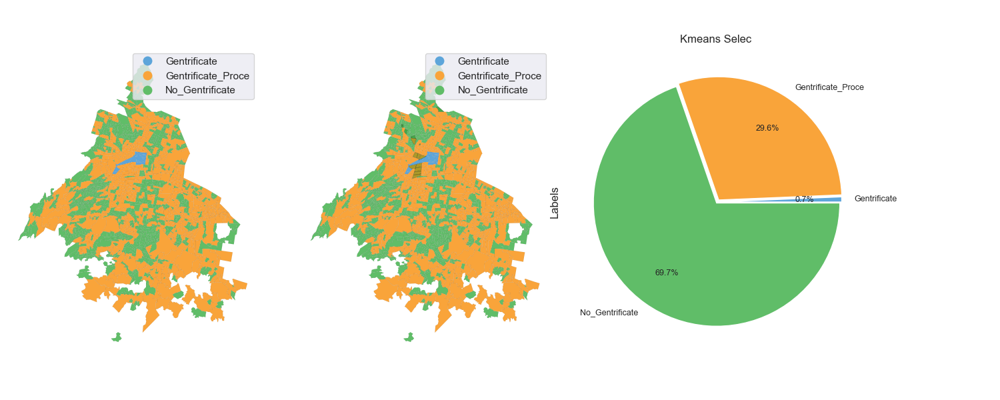

In [181]:
# Select features  
result_features=last_df
df=model_ubi(df_end=result_features)

# Seleción de Colonias

In [182]:
list(df["Labels"].unique())

['No_Gentrificate', 'Gentrificate_Proce', 'Gentrificate']

In [183]:
df[df["Labels"]=='No_Gentrificate'].head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,...,Tsa_N_Hotel room-Hotel room,Tsa_price-Hotel room,Tsa_number_of_reviews-Hotel room,Tsa_availability_365-Hotel room,Tsa_N_Shared room-Shared room,Tsa_price-Shared room,Tsa_number_of_reviews-Shared room,Tsa_availability_365-Shared room,Predict,Labels
0,AGUILERA,1,"POLYGON ((-99.15901 19.47374, -99.15882 19.473...",0,827.0,608.0,10.244000,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,No_Gentrificate
1,ALDANA,2,"POLYGON ((-99.14858 19.47156, -99.14863 19.471...",0,1589.0,1133.0,10.845652,1.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0,No_Gentrificate


In [184]:
df[df["Labels"]=='Gentrificate_Proce'].head(2)

,NOMUT,ID,geometry,N_Mercados,P30A59A,TVIPAHAB,GRAPROES,N_Tianguis,N_Comerci,N_Patri,...,Tsa_N_Hotel room-Hotel room,Tsa_price-Hotel room,Tsa_number_of_reviews-Hotel room,Tsa_availability_365-Hotel room,Tsa_N_Shared room-Shared room,Tsa_price-Shared room,Tsa_number_of_reviews-Shared room,Tsa_availability_365-Shared room,Predict,Labels
4,CENTRO DE AZCAPOTZALCO,5,"POLYGON ((-99.18959 19.48519, -99.18946 19.485...",1,1422.0,1138.0,9.730323,1.0,0.0,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,Gentrificate_Proce
5,CLAVERIA,6,"POLYGON ((-99.18748 19.46948, -99.18636 19.469...",1,4188.0,3263.0,13.165714,1.0,0.0,3.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2,Gentrificate_Proce


In [209]:
df_model_4[df_model_4["Labels"]=='Gentrificate']

,NOMUT,ID,geometry,P30A59A,TVIPAHAB,GRAPROES,N_Mercados,N_Patri,N_CeCo,serv,...,Tsa_N_Entire home/apt-Entire home/apt,Tsa_price-Entire home/apt,Tsa_N_Private room-Private room,Tsa_price-Private room,Tsa_N_Hotel room-Hotel room,Tsa_number_of_reviews-Hotel room,Tsa_availability_365-Hotel room,Tsa_N_Shared room-Shared room,Predict,Labels
143,NAPOLES,144,"POLYGON ((-99.17050 19.39979, -99.17087 19.398...",9262.0,7499.0,14.474267,0,1.0,3.0,4311,...,22.916667,1.058888,3.243243,-38.606107,14.285714,22.500000,-12.461589,0.000000,1,Gentrificate
224,CHAPULTEPEC MORALES (POLANCO),225,"POLYGON ((-99.18345 19.43142, -99.18418 19.431...",4020.0,3392.0,12.508478,0,1.0,6.0,1651,...,33.173077,-30.143389,-17.142857,0.588342,0.000000,214.285714,-3.316867,0.000000,1,Gentrificate
268,EL ROSEDAL II,269,"POLYGON ((-99.15017 19.33996, -99.15012 19.339...",1210.0,913.0,14.696000,0,0.0,0.0,597,...,0.000000,25.186567,-50.000000,24.031008,0.000000,160.000000,8.383234,0.000000,1,Gentrificate
417,CENTRO I,418,"POLYGON ((-99.13876 19.44396, -99.13786 19.443...",2877.0,2153.0,8.461622,4,2.0,8.0,3240,...,50.000000,46.041749,0.000000,-36.300246,0.000000,0.000000,0.000000,0.000000,1,Gentrificate
418,CENTRO II,419,"POLYGON ((-99.13531 19.43964, -99.13527 19.440...",3694.0,2835.0,9.861429,0,2.0,17.0,4068,...,-6.976744,1.904680,-50.000000,-25.021301,0.000000,0.000000,0.000000,0.000000,1,Gentrificate
419,CENTRO III,420,"POLYGON ((-99.13330 19.43938, -99.13125 19.439...",2668.0,2111.0,8.611667,3,1.0,22.0,4093,...,13.157895,-8.653827,22.727273,-13.850657,0.000000,0.000000,-14.246575,0.000000,1,Gentrificate
420,CENTRO IV,421,"POLYGON ((-99.13531 19.43964, -99.13556 19.437...",3050.0,2485.0,7.857467,0,1.0,27.0,5968,...,15.865385,2.540480,-1.769912,75.399753,-20.000000,75.000000,30.984596,68.750000,1,Gentrificate
421,CENTRO V,422,"POLYGON ((-99.14164 19.42905, -99.13901 19.428...",1583.0,1185.0,9.893158,0,1.0,1.0,4078,...,13.333333,9.146508,6.666667,-6.768679,0.000000,0.000000,0.000000,112.500000,1,Gentrificate
422,CENTRO VI,423,"POLYGON ((-99.14200 19.42691, -99.14187 19.426...",4433.0,3381.0,7.881273,1,2.0,6.0,2136,...,3.846154,-4.690045,2.380952,1.883927,0.000000,0.000000,0.000000,100.000000,1,Gentrificate
423,CENTRO VII,424,"POLYGON ((-99.12958 19.43542, -99.12877 19.435...",3292.0,2294.0,8.826792,0,1.0,16.0,1978,...,-11.111111,7.800624,100.000000,-18.390288,0.000000,0.000000,0.000000,0.000000,1,Gentrificate


(-99.3706147340889, -98.9254116112407, 19.10409854519826, 19.617099526518338)

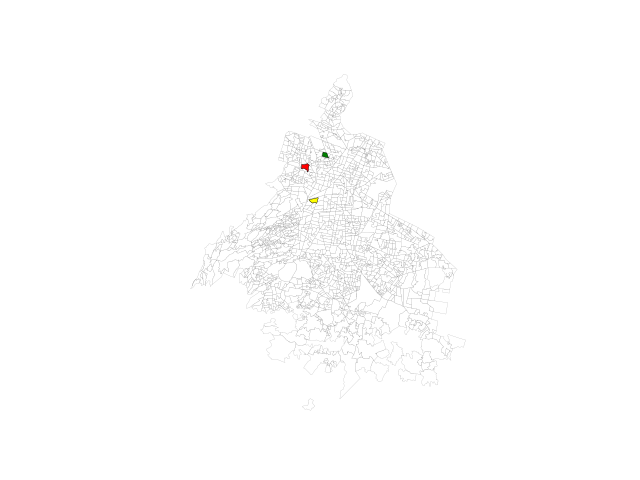

In [186]:
# Setup figure and axis
f, ax = plt.subplots(1)
df_col_43.plot(ax=ax, facecolor='grey', linewidth=0.05, color='white', edgecolor='black')
# No Gentrificate
df[df["NOMUT"]=='COLTONGO'].plot(ax=ax,alpha=1, linewidth=0.3, color="green", edgecolor='black')
df[df["NOMUT"]=='CLAVERIA'].plot(ax=ax,alpha=1, linewidth=0.3, color="red", edgecolor='black')
df[df["NOMUT"].str.contains("ROMA")].head(1).plot(ax=ax,alpha=1, linewidth=0.3, color="Yellow", edgecolor='black')
ax.axis("off")

# Experimentos 

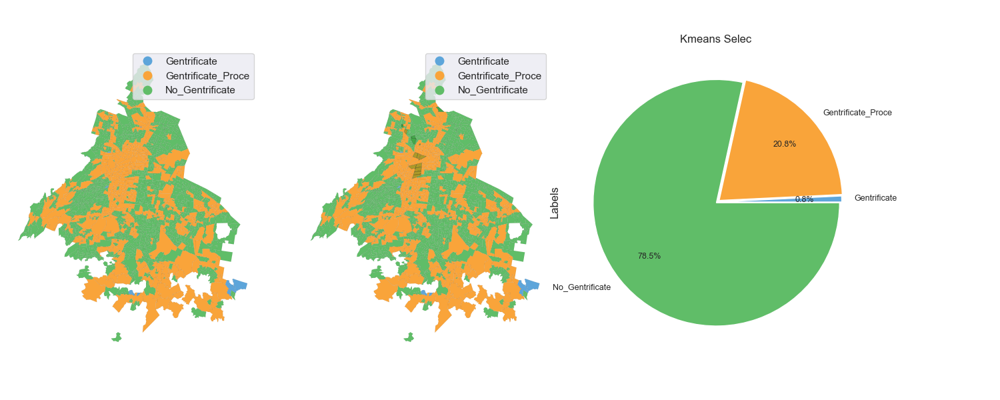

In [187]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        # 'TVIPAHAB',
        'GRAPROES',
        # 'N_Mercados', 
        # 'N_Tianguis', 
        # 'N_Comerci', 
        'N_Patri',
       # 'N_Plaza',  ***
        'N_CeCo',
       # 'ue',
        # 'ind', 
        # 'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        'T_creci_Densi',
        # 'clv_ingre', 
        # 'Id'
                                 
                                 
        ]]
df_model_1=model_ubi(df_end=result_features)

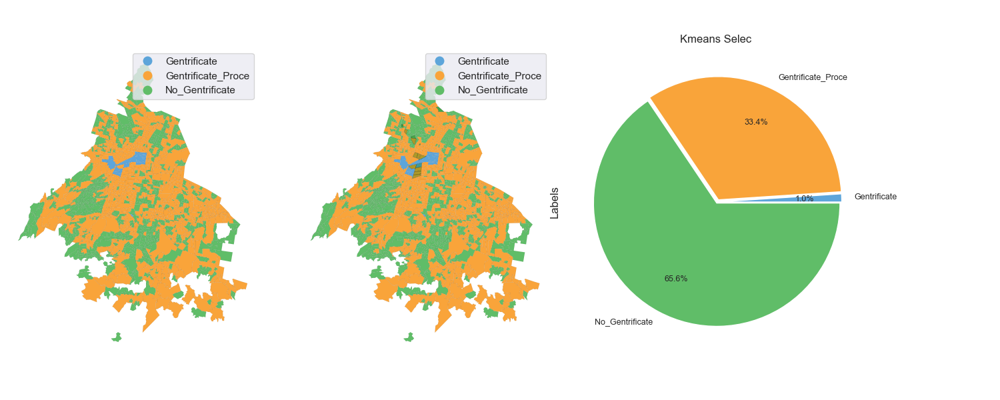

In [188]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        # 'TVIPAHAB',
        'GRAPROES',
        # 'N_Mercados',        
        # 'N_Tianguis', 
        'N_Comerci', 
        'N_Patri',
       'N_Plaza',  
        'N_CeCo',
       # 'ue',
        # 'ind', 
        'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        'T_creci_Densi',
        # 'clv_ingre', 
        'Id',
        'Tsa_N_Entire home/apt-Entire home/apt',                        
       # 'Tsa_price-Entire home/apt', 
       # 'Tsa_number_of_reviews-Entire home/apt',
       # 'Tsa_availability_365-Entire home/apt',
       # 'Tsa_N_Private room-Private room', 
      # 'Tsa_price-Private room',
                                 
       'Tsa_number_of_reviews-Private room',
                                 
       # 'Tsa_availability_365-Private room', 
                                 
        'Tsa_N_Hotel room-Hotel room',
       'Tsa_price-Hotel room', 
        'Tsa_number_of_reviews-Hotel room',
       # 'Tsa_availability_365-Hotel room', 
        'Tsa_N_Shared room-Shared room',
       # 'Tsa_price-Shared room', 
        # 'Tsa_number_of_reviews-Shared room',
       # 'Tsa_availability_365-Shared room'
                                 
                                 
        ]]
df_model_2=model_ubi(df_end=result_features)

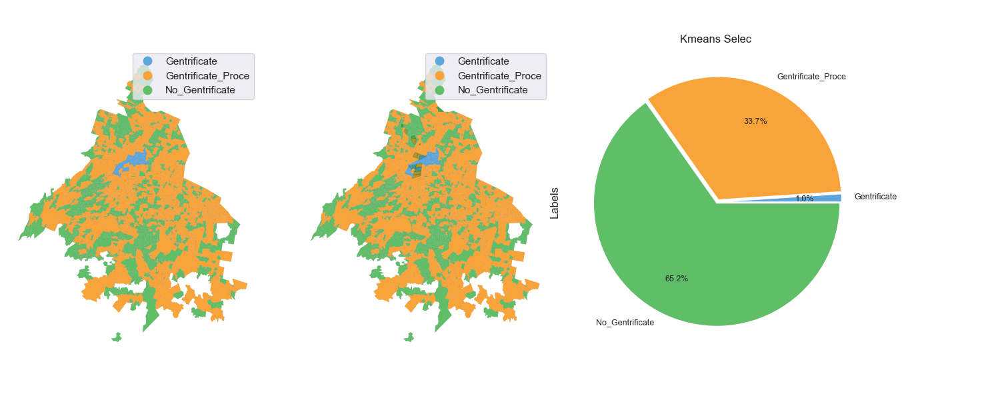

In [189]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        'TVIPAHAB',
        'GRAPROES',
        'N_Mercados',        
        # 'N_Tianguis', 
        'N_Comerci', 
        'N_Patri',
       'N_Plaza',  
        'N_CeCo',
       # 'ue',
        # 'ind', 
        'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        'T_creci_Densi',
        # 'clv_ingre', 
        'Id',
        'Tsa_N_Entire home/apt-Entire home/apt',                        
       # 'Tsa_price-Entire home/apt', 
       # 'Tsa_number_of_reviews-Entire home/apt',
       # 'Tsa_availability_365-Entire home/apt',
       'Tsa_N_Private room-Private room', 
      # 'Tsa_price-Private room',
                                 
       # 'Tsa_number_of_reviews-Private room',
                                 
       # 'Tsa_availability_365-Private room', 
                                 
        'Tsa_N_Hotel room-Hotel room',
       # 'Tsa_price-Hotel room', 
           # 'Tsa_availability_365-Hotel room', 
        'Tsa_N_Shared room-Shared room',
       # 'Tsa_price-Shared room', 
        # 'Tsa_number_of_reviews-Shared room',
       # 'Tsa_availability_365-Shared room'
                                 
                                 
        ]]
df_model_3=model_ubi(df_end=result_features)

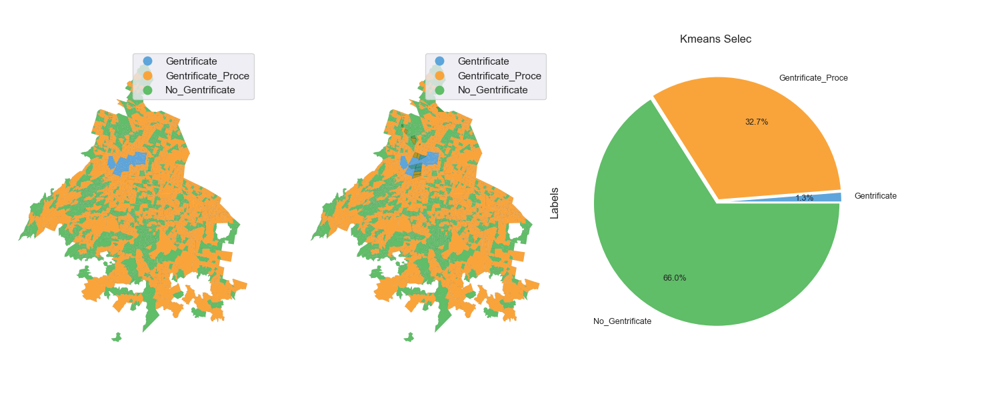

In [207]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        'TVIPAHAB',
        'GRAPROES',
        'N_Mercados',        
        # 'N_Tianguis', 
        'N_Comerci', 
        'N_Patri',
       'N_Plaza',  
        'N_CeCo',
       # 'ue',
        # 'ind', 
        'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        'T_creci_Densi',
        # 'clv_ingre', 
        'Id',
        'Tsa_N_Entire home/apt-Entire home/apt',                        
       # 'Tsa_price-Entire home/apt', 
       # 'Tsa_number_of_reviews-Entire home/apt',
       # 'Tsa_availability_365-Entire home/apt',
       'Tsa_N_Private room-Private room', 
      # 'Tsa_price-Private room',
                                 
       # 'Tsa_number_of_reviews-Private room',
                                 
       'Tsa_availability_365-Private room', 
                                 
        'Tsa_N_Hotel room-Hotel room',
       # 'Tsa_price-Hotel room', 
            'Tsa_number_of_reviews-Hotel room',
         # 'Tsa_availability_365-Hotel room', 
        'Tsa_N_Shared room-Shared room',
       # 'Tsa_price-Shared room', 
        # 'Tsa_number_of_reviews-Shared room',
       # 'Tsa_availability_365-Shared room'
                                 
                                 
        ]]
df_model_3=model_ubi(df_end=result_features)

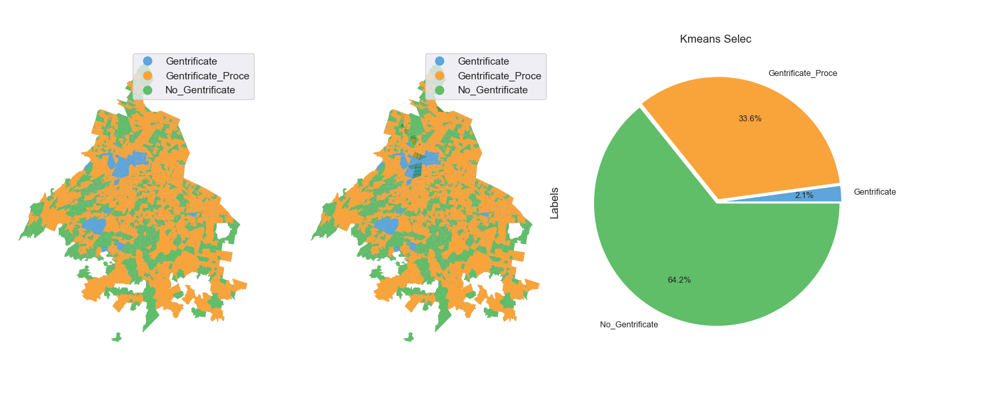

In [208]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        'TVIPAHAB',
        'GRAPROES',
        'N_Mercados',        
        # 'N_Tianguis', 
        # 'N_Comerci', 
        'N_Patri',
       # 'N_Plaza',  
        'N_CeCo',
       # 'ue',
        # 'ind', 
        # 'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        # 'T_creci_Densi',
        # 'clv_ingre', 
        'Id',
        'Tsa_N_Entire home/apt-Entire home/apt',                        
       'Tsa_price-Entire home/apt', 
       # 'Tsa_number_of_reviews-Entire home/apt',
       # 'Tsa_availability_365-Entire home/apt',
       'Tsa_N_Private room-Private room', 
      'Tsa_price-Private room',
                                 
       # 'Tsa_number_of_reviews-Private room',
                                 
       # 'Tsa_availability_365-Private room', 
                                 
        'Tsa_N_Hotel room-Hotel room',
       # 'Tsa_price-Hotel room', 
            'Tsa_number_of_reviews-Hotel room',
         'Tsa_availability_365-Hotel room', 
        'Tsa_N_Shared room-Shared room',
       # 'Tsa_price-Shared room', 
        # 'Tsa_number_of_reviews-Shared room',
       # 'Tsa_availability_365-Shared room'
                                 
                                 
        ]]
df_model_4=model_ubi(df_end=result_features)

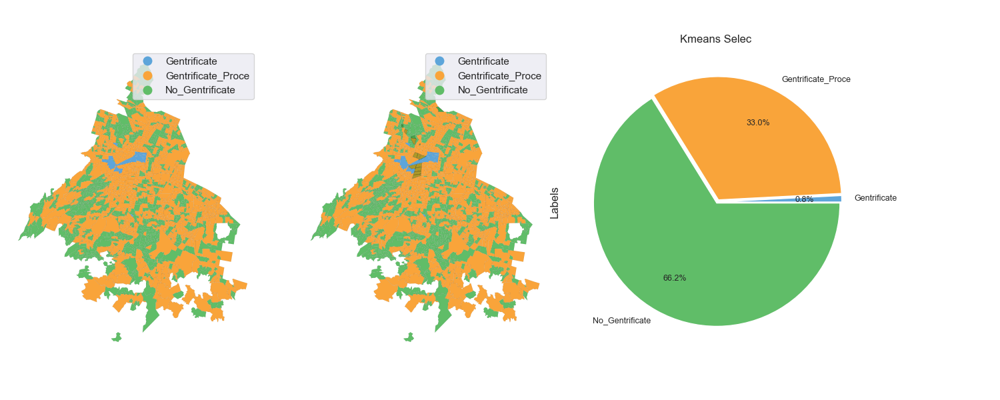

In [192]:
# Select features  
result_features=last_df
# result_features=result_features.drop(columns=["N_CeCo","N_Patri"])
result_features=result_features[["NOMUT","ID","geometry",
        'P30A59A', 
        'TVIPAHAB',
        'GRAPROES',
        'N_Mercados',        
        # 'N_Tianguis', 
        # 'N_Comerci', 
        'N_Patri',
       'N_Plaza',  
        'N_CeCo',
       # 'ue',
        # 'ind', 
        'com', 
        'serv', 
        # 'sup_ha',
        # 'T_creci_Pobla', 
        'T_creci_Densi',
        # 'clv_ingre', 
        'Id',
        'Tsa_N_Entire home/apt-Entire home/apt',                        
       'Tsa_price-Entire home/apt', 
       # 'Tsa_number_of_reviews-Entire home/apt',
       'Tsa_availability_365-Entire home/apt',
       'Tsa_N_Private room-Private room', 
      'Tsa_price-Private room',
                                 
       'Tsa_number_of_reviews-Private room',
                                 
       'Tsa_availability_365-Private room', 
                                 
        'Tsa_N_Hotel room-Hotel room',
       'Tsa_price-Hotel room', 
            'Tsa_number_of_reviews-Hotel room',
         'Tsa_availability_365-Hotel room', 
        'Tsa_N_Shared room-Shared room',
       'Tsa_price-Shared room', 
        # 'Tsa_number_of_reviews-Shared room',
       # 'Tsa_availability_365-Shared room'
                                 
                                 
        ]]
df_model_5=model_ubi(df_end=result_features)

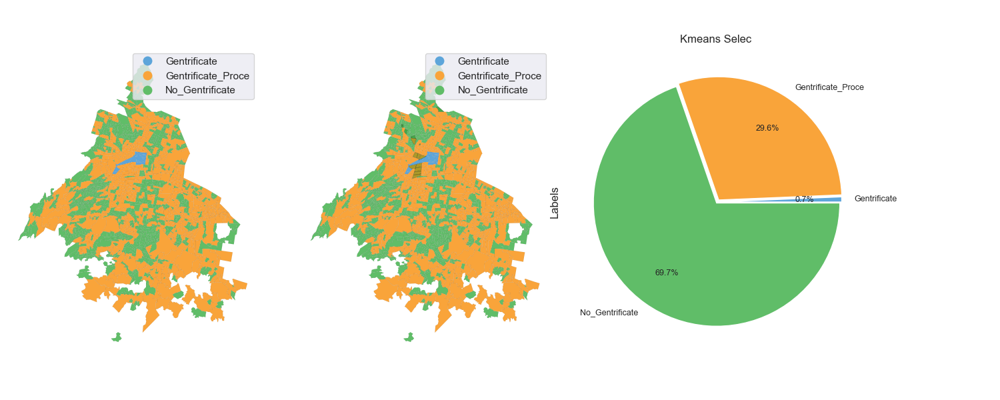

In [193]:
# Select features  
result_features=last_df
df=model_ubi(df_end=result_features)

# Kmeans VS Her Clustering

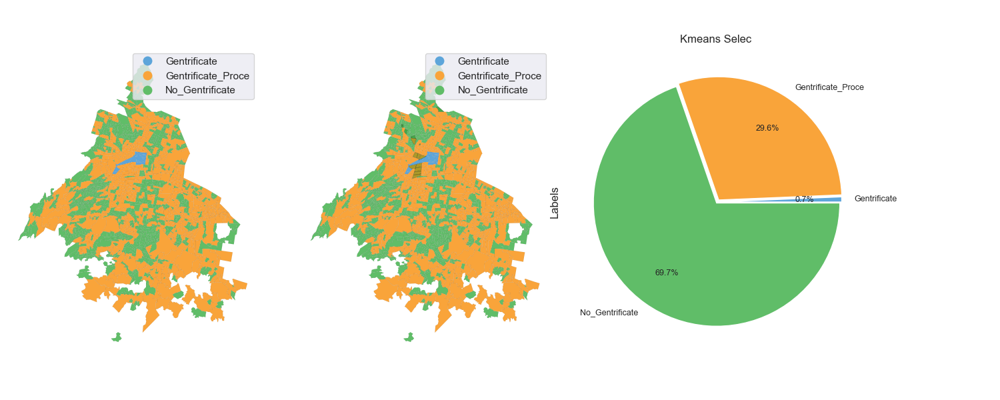

In [194]:
# Select features  
result_features=last_df
df=model_ubi(df_end=result_features,model="Kmeans")

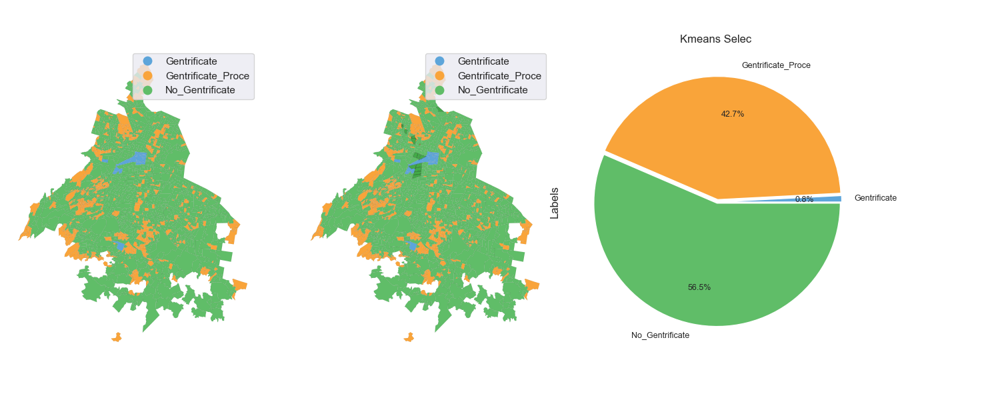

In [195]:
# Select features  
result_features=last_df
df=model_ubi(df_end=result_features,model="hc")

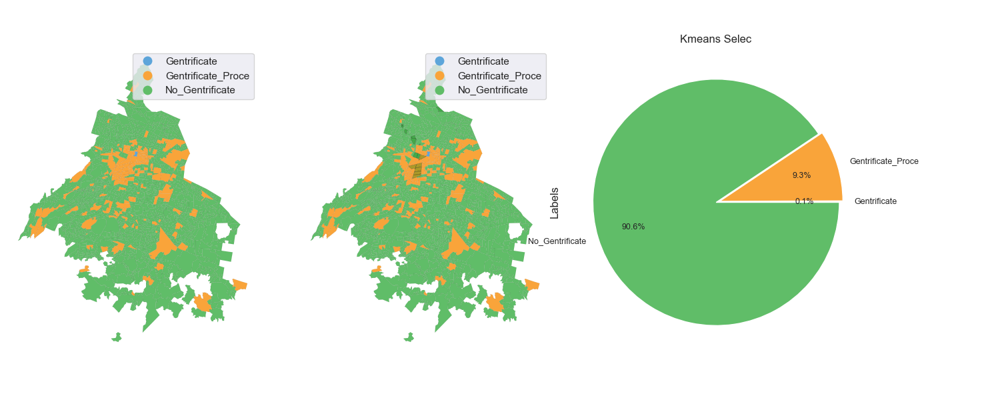

In [196]:
# Select features  
result_features=last_df
df=model_ubi(df_end=result_features,model="GMM")

# Instagram Post

##  Colonia Molino_De_Rosas (En proceso de GEntrificación)

In [197]:
data_dates =pd.read_pickle('data/Scrap/Molino_De_Rosas_2016.pkl')

In [198]:
data_dates.head(2)

,Dates
0,ENERO 18
1,FEBRERO 2


In [199]:
data_dates.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 704 entries, 0 to 703
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   Dates   704 non-null    object
dtypes: object(1)
memory usage: 5.6+ KB


In [200]:
locale.setlocale(locale.LC_TIME, '')

def convert_time(datetime_str):
    # display( datetime_str)
    try:
        return datetime.strptime(datetime_str.lower(), "%B %d, %Y")
    except:
        try:
            datetime_str=datetime_str +", 2022"
            return datetime.strptime(datetime_str.lower(), "%B %d, %Y")
        except:
            pass
       


In [201]:
data_dates['dates_format']=data_dates['Dates'].apply(convert_time)
count_post_mon=data_dates.groupby(pd.Grouper(key='dates_format', axis=0, 
                      freq='M'))['dates_format'].count().rename_axis(['date']).reset_index().rename(columns={'dates_format': "total_post_dia"})

In [202]:
count_post_mon.head(2)

,date,total_post_dia
0,2014-09-30,16
1,2014-10-31,0


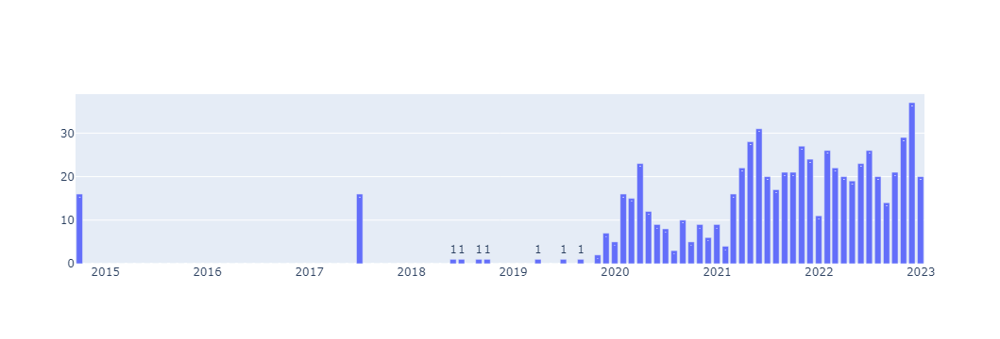

In [203]:
fig = go.Figure([go.Bar(x=count_post_mon['date'], y=count_post_mon['total_post_dia'], text=count_post_mon['total_post_dia'])])
fig.show()

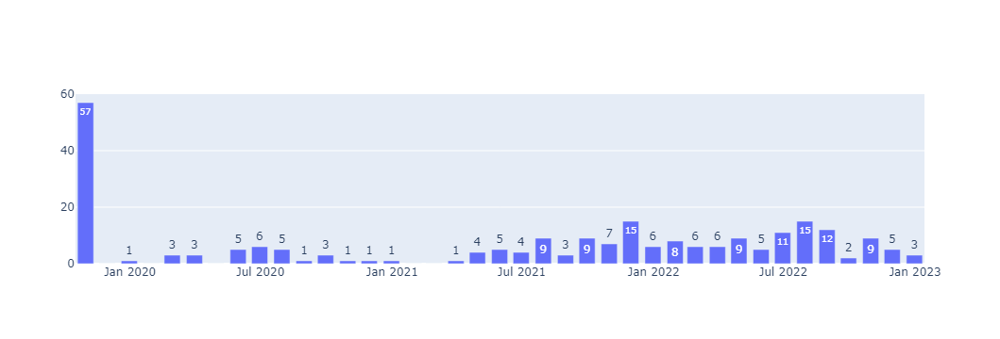

In [204]:
data_dates =pd.read_pickle('data/Scrap/coltongo_2016.pkl')

data_dates['dates_format']=data_dates['Dates'].apply(convert_time)
count_post_mon=data_dates.groupby(pd.Grouper(key='dates_format', axis=0, 
                      freq='M'))['dates_format'].count().rename_axis(['date']).reset_index().rename(columns={'dates_format': "total_post_dia"})

fig = go.Figure([go.Bar(x=count_post_mon['date'], y=count_post_mon['total_post_dia'], text=count_post_mon['total_post_dia'])])
fig.show()

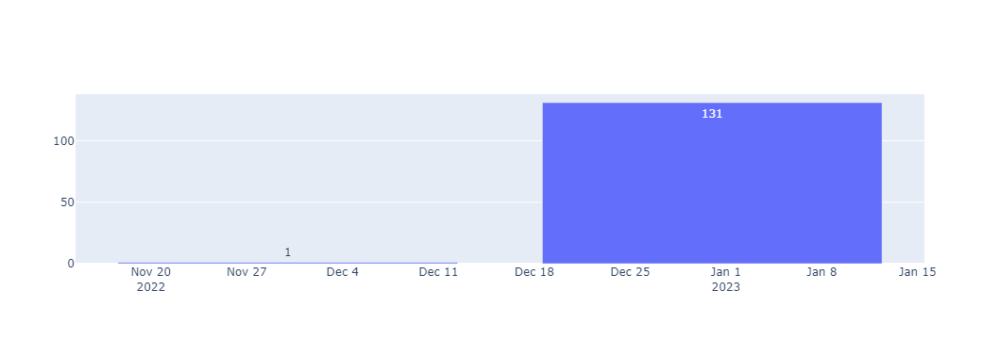

In [205]:
data_dates =pd.read_pickle('data/Scrap/dates_roma_2016.pkl')

data_dates['dates_format']=data_dates['Dates'].apply(convert_time)
count_post_mon=data_dates.groupby(pd.Grouper(key='dates_format', axis=0, 
                      freq='M'))['dates_format'].count().rename_axis(['date']).reset_index().rename(columns={'dates_format': "total_post_dia"})

fig = go.Figure([go.Bar(x=count_post_mon['date'], y=count_post_mon['total_post_dia'], text=count_post_mon['total_post_dia'])])
fig.show()

# Comparación Colonias Centrificadas (Estudios Anteriores)

* [Gentrificación; fenómeno desatendido en la Ciudad de México](https://www.realestatemarket.com.mx/noticias/25496-gentrificacion-fenomeno-desatendido-en-la-ciudad-de-mexico)
* [¿Qué es la gentrificación y por qué debería preocuparnos a los ‘chilangos’? – El Financiero](https://www.elfinanciero.com.mx/cdmx/2022/02/18/que-es-la-gentrificacion-y-por-que-deberia-preocuparnos-a-los-chilangos/)
* [La gentrificación de colonias céntricas genera desplazados de la ciudad a la periferia](https://www.dgcs.unam.mx/boletin/bdboletin/2015_750.html)
* [Gentrificación y desastre en la Zona de La Condesa1](https://www.redalyc.org/journal/748/74855211005/html/#fn1)
*[LA GENTRIFICACIÓN DE LA COLONIA CONDESA, CIUDAD DE MÉXICO. APORTE PARA UNA DISCUSIÓN DESDE LATINOAMÉRICA | Revista Geográfica de América Central](https://www.revistas.una.ac.cr/index.php/geografica/article/view/5993)
* [Ciudad de México, quince años de desarrollo urbano intensivo: la gentrificación percibida](https://www.scielo.cl/scielo.php?script=sci_arttext&pid=S0718-83582016000300004)

* [2015_Gentrificacion_MEX_AL_entero.pdf](http://contested-cities.net/wp-content/uploads/2016/01/2015_Gentrificacion_MEX_AL_4_Olivera-1.pdf)

* [La gentrificación acorrala a los barrios del centro de Ciudad de México | EL PAÍS México](https://elpais.com/mexico/2022-09-20/la-gentrificacion-acorrala-a-los-barrios-del-centro-de-ciudad-de-mexico.html)

* [¿Qué es la gentrificación y cómo afecta a la CDMX?](https://obras.expansion.mx/inmobiliario/2022/02/18/que-es-la-gentrificacion#:~:text=La%20gentrificaci%C3%B3n%20en%20la%20CDMX,que%20migrar%20a%20zonas%20aleda%C3%B1as.)